In [612]:
import os
import math
import zipfile
import pickle
# Essential Libraries
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import datetime
import geopandas as gpd
from shapely.geometry import Point
# Preprocessing
from sklearn.preprocessing import MinMaxScaler
# Algorithms
# from minisom import MiniSom
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from zipfile import ZipFile


os.chdir("../../")

In [255]:
from MSMC_clustering import Msmc_clustering

unnormalized_msmc_obj = Msmc_clustering(directory="msmc_curve_data/", 
                                        mu=1.4e-9, 
                                        generation_time_path='generation_lengths/', 
                                        real_time=True, 
                                        to_omit=[],
                                        normalize_lambda=False, 
                                        log_scale_time=True, 
                                        plot_on_log_scale=True, 
                                        exclude_subdirs=["Archive", "mammals_part_1"], 
                                        manual_cluster_count=8,
                                        algo='kmeans')

unnormalized_msmc_obj.name2series

fileLen: 11126
duplicate entries: 0
fileLen: 5427
duplicate entries: 0


{'Casuarius_casuarius_GCA_013396415.1_msmc2.final':             left_time_boundary  right_time_boundary        lambda
 time_index                                                       
 1                     4.715520             0.000012  5.094232e+04
 2                     5.033905             0.000019  5.094232e+04
 3                     5.227577             0.000027  5.094232e+04
 4                     5.370316             0.000035  1.318834e+05
 5                     5.485249             0.000044  1.318834e+05
 ...                        ...                  ...           ...
 59                    7.808564             0.008029  2.622329e+08
 60                    7.842935             0.008690  2.622329e+08
 61                    7.877281             0.009405  2.622329e+08
 62                    7.911604             0.010178  2.622329e+08
 63                    7.945905                  inf  2.622329e+08
 
 [63 rows x 3 columns],
 'Loxia_curvirostra_GCA_013398455.1_msmc2.final':   

In [1375]:
regular_msmc_obj = Msmc_clustering(directory="msmc_curve_data/", 
                                   mu=1.4e-9, 
                                   generation_time_path='generation_lengths/', 
                                   real_time=True, 
                                   to_omit=[],
                                   normalize_lambda=True, 
                                   log_scale_time=True, 
                                   plot_on_log_scale=True, 
                                   exclude_subdirs=["Archive", "mammals_part_1"], 
                                   manual_cluster_count=30,
                                   algo='kmeans')


fileLen: 11126
duplicate entries: 0
fileLen: 5427
duplicate entries: 0


cleanSeries_with_df: 238,
mySeries: 238
mySeries: 63
Clustering 63/64
Omitting 0 points from front and 0 from back
kmeans dtw
type of cleanSeries <class 'numpy.ndarray'>
shape of cleanSeries (238, 63, 2)
Computed dists of shape: (238, 238)
<class 'tslearn.clustering.kmeans.TimeSeriesKMeans'>
sample len: 238
label len: 238
num to plot : 30
curve cluster plot shape: (8, 4)


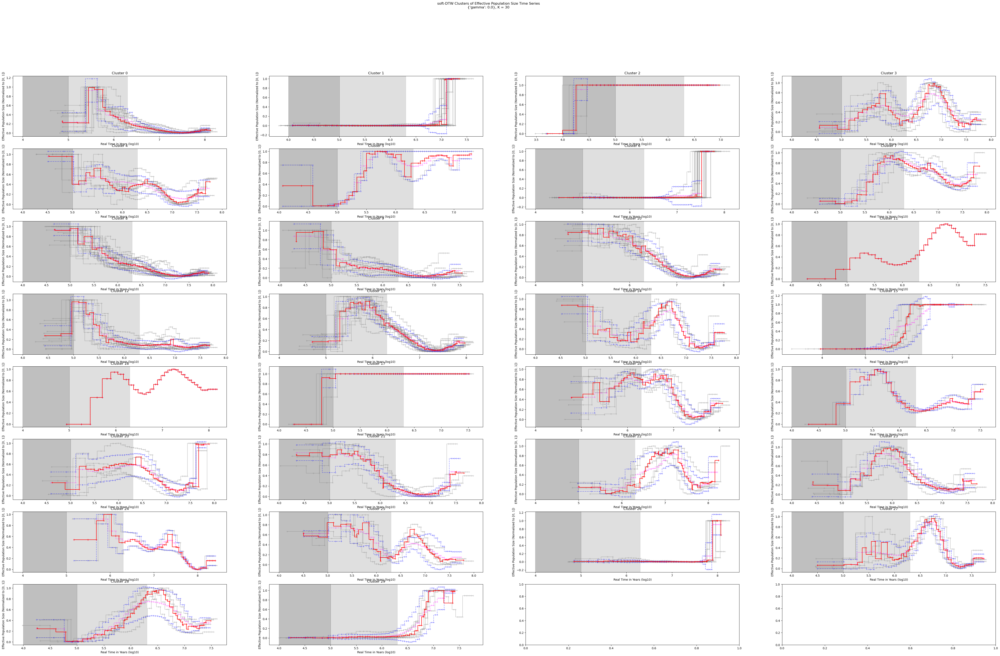

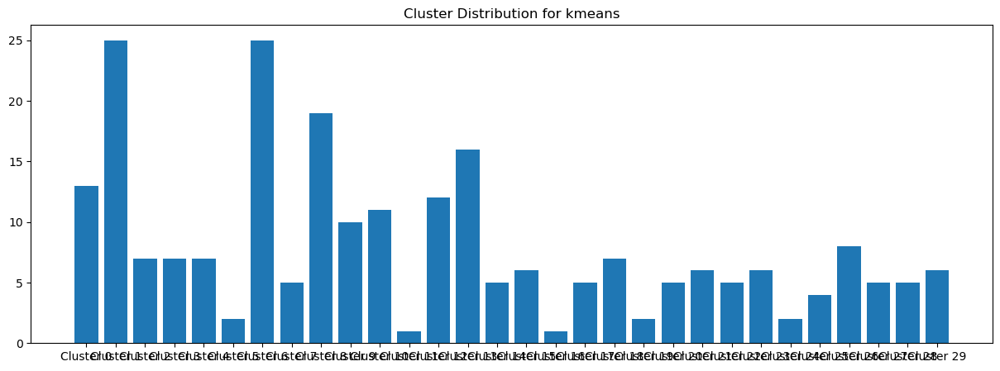

DID I CLOSE THE PLOT??? PLEASE TELL ME I DID!


In [1377]:
regular_msmc_obj.cluster_curves(omit_front=0, 
                                omit_back=0, 
                                cols=4,  
                                fs_x=60, 
                                fs_y=35,
                                metric_params={"gamma" : 0.0})

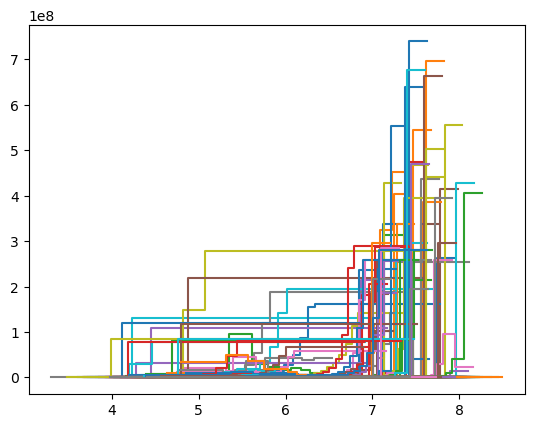

In [264]:
for s in list(unnormalized_msmc_obj.name2series.values()):
    x, y = zip(*s.drop(["right_time_boundary"], axis=1).to_numpy())
    # y = unnormalized_msmc_obj.name2series["lambda"].to_numpy()
    plt.step(x, y)


# Goals: 
- Run anova on my favorite trait (HWI or mass)
    - ANOVA will tell me if there is something going on within the trait grouping, but not what specifically (nothing like between group diffs)
    - For traits that return a nice ANOVA result, see if their within cluster groupings are sig (T-test on the means of each box -> find p-value for diff)
    - Rerun normalization with something like the median instead of the max
    - Repeat ANOVA to see if anything improved
    - Find a value like inertia or some sort of time series variance 
    - Labels: Curve Cluster Assignments
    - Features: ANOVA Traits (Continuous values)
    
- Generate boxplots of bird wing size (of birds within sample) over cluster labels
    - Identify the trait with the most inter-cluster variation
- Generate some hists of categorical data for each cluster label

- Get out some trait data like size and see if delta stat and rtrees yield anything intersting
    - Test pagel's lambda on bird sizes
    - Traits of interest in data:
        - Categorical:
            - Trophic.Niche
            - Primary.Lifestyle
            - Habitat
            - Species.Status
        - Continuous: 
            - Geography
            - Body features

- Determine if delta statistic is suitable for determining phylogenetic signal for traits of categorical data

# Note: Some names are found in the cluster labels df but not avonet3
Potential cause is that the cluster labels names aren't actually the most widely recognized scientific names of the birds. Manually check these bogus bird names, AVONET usable scientific names are typically taxonomical synonyms or old names of these clusterLabel names.
# Output:
The name changes done on our cluster label indices ("Latin names") data are performed in function below. Function also reads in data

In [150]:
from MSMC_clustering import Msmc_clustering

from tslearn.barycenters import dtw_barycenter_averaging
key_label_dict
translated_ts_dict_latin_keyed

def plot_cluster_table(cluster_table=False,
                       Msmc_clustering_obj=False,
                       cluster_label_dict=False,
                       cluster_ts_dict=False,
                       basic_cluster_ts_dict=False,
                       clusts = 8,
                       x_aspect = 64,
                       y_aspect = 8,
                       cols = 4,
                       plot_barycenters = True,
                       max_iter=5):
#     from tslearn.barycenters import dtw_barycenter_averaging

    '''
    Given a cluster table and a Msmc_clustering object (loaded with time series
    data which has been transformed into real time via coal. theory), plot out
    time series curves in their respective clusters. Plotting barycenters is
    optional.

    3 methods of plotting depending on which parameter is used:
    - cluster_label_dict: Dict mapping of sample ID to assigned cluster label
    - cluster_ts_dict: Dict mapping of sample ID to corresponding time series; 
        time series is in the format of the dataframe:
        MSMC_clustering.Msmc_clustering.name2series attribute
    - basic_cluster_ts_dict: Dict mapping of sample ID to corresponding
        time series; timeseries is in the basic format of a numpy array 
        {sample ID: timeseries np.array}
    '''
    if cluster_table and Msmc_clustering_obj:
        # iterate over items in sample2label_series and plot them into axs
        method = 1
        labels = cluster_table.Labels.unique()
        indices = cluster_table.index
    elif cluster_label_dict:  # If cluster assignments are known
        if cluster_ts_dict: # If given mapping of sample to ts in my custom format
            method = 2
        elif basic_cluster_ts_dict: # If given in basic format 
            method = 3
        labels = set(list(cluster_label_dict.values()))
        indices = list(cluster_label_dict.keys())
        
    rows = int(np.ceil(clusts/cols)) # always have 4 columns, row = clusts//4
    fs_x = x_aspect
    fs_y = y_aspect * rows
    fig, axs = plt.subplots(rows, cols, figsize=(fs_x, fs_y))
    plt.suptitle(f"Time Series Clusters", fontsize=40)
    label2series = {label:[] for label in labels} # Maps label to timeseries
    for idx in indices:
        if method == 1: # Given MSMC_clustering obj
            label = cluster_table.loc[idx].Labels 
            df = Msmc_clustering_obj.name2series[cluster_table.loc[idx].Sample].drop(["right_time_boundary"], axis=1)
            label2series[label].append(df.to_numpy())
            NE = df["lambda"].to_numpy()
            time = df["left_time_boundary"].to_numpy()
        elif method == 2: # Given pd.df from an attribute of my MSMC_clustering obj
            label = cluster_label_dict[idx]
            df = cluster_ts_dict[idx].drop(["right_time_boundary"], axis=1)
            label2series[label].append(df.to_numpy())
            NE = df["lambda"].to_numpy()
            time = df["left_time_boundary"].to_numpy()
        elif method == 3: # Given basic sample ID to np.array dict mapping
            label = cluster_label_dict[idx]
            if len(basic_cluster_ts_dict[idx].shape) == 1: # If we have 1D ts
                NE = basic_cluster_ts_dict[idx]
                time = list(range(len(basic_cluster_ts_dict[idx])))
            elif len(basic_cluster_ts_dict[idx].shape) == 2: # If we have 2D ts
                # I'm assuming ts will be [(x_val aka time, y_val aka Ne), ...]
                time, NE = zip(*basic_cluster_ts_dict[idx].tolist())
            label2series[label].append(basic_cluster_ts_dict[idx])
            
        if rows <= 1:
            ax = axs[label%cols] # subplot ax only requires col
        else:
            ax = axs[label//cols, label%cols]
        ax.step(time, NE, "+-", c="grey", alpha=0.4)
        ax.set_title(f"Cluster {label}", fontsize=30)
        ax.tick_params(axis='x', labelsize=20)
        ax.tick_params(axis='y', labelsize=20)

    # After a pass over all data, we can plot barycenters for each cluster
    if plot_barycenters:
        for item in label2series.items():
            label = item[0]
            data = item[1] # This is a df of the MSMC_clustering attribute format again
            barycenter = dtw_barycenter_averaging(data, max_iter=max_iter)
            if len(barycenter.shape) == 3:
                x, y = zip(*barycenter)
            elif len(barycenter.shape) == 2:
                y = barycenter
                x = list(range(len(y)))
            if rows <= 1:
                ax = axs[label%cols] # subplot ax only requires col
            else:
                ax = axs[label//cols, label%cols]
            ax.step(x, y, "+-", c="red", alpha=0.8)
    
    

In [130]:
def grab_silhouette_test_clusterlabels(df_avonet3, translate2avonet3=True, verbose=False, verboser=False):
    '''
    Function returns a dict of dfs containing the clustering labels of each
    combination of gamma and clusternumber

    Also adapts clustering label dataframe's Latin name column to whatever
    Latin names are used in AVONET3. For some reason there are name
    inconsistencies which I had to manually fix
    '''
    path = "../"
    clusteringListPath = path + "results/silhouette-tests/lists/"
    gamma_clustnum_df_holder = dict()
    gammas = [np.round(i, 1) for i in np.arange(0.1, 1, 0.2)]
    gammas.insert(0, 0.0)
    clustnums = np.arange(2, 21, 1)
    for gamma in gammas:
        for clustnum in clustnums:
            tsv_path = clusteringListPath + f"gamma_{gamma}/clusternum_{clustnum}/gamma_{gamma}_clusternum_{clustnum}.tsv"
            gamma_clustnum_df_holder[f"gamma_{gamma}_clustnum_{clustnum}"] = pd.read_csv(tsv_path, sep="\t")
            if f"clusternum_{clustnum}" in os.listdir(clusteringListPath + f"gamma_{gamma}/") and translate2avonet3:
                # Begin adaptation of dataframe indices to known AVONET3 dataframe indices
                # e.g. Edolisoma coerulescens in B10K labeling is AKA Coracina coerulescens on Google and Avonet3
                scinames = ["Gallicolumba beccarii", "Pycnonotus atriceps", "Callaeas cinereus", "Larus maculipennis",
                        "Platysteira castanea", "Coracina coerulescens", "Cettia vulcania", "Oceanodroma tethys",
                        "Larus argentatus", "Nectarinia aspasia", "Eupodotis_ruficrista", "Rostratula semicollaris", 
                        "Parus atricapillus", "Megalaima haemacephala", "Phylloscopus sibilatrix", "Dendroica kirtlandii",
                        "Paradoxornis webbianus", "Stachyris dennistouni", "Porzana atra"] # Hand picked/found scientific names (found in alphabetical order of OG names)
                ogNames = sorted([i for i in gamma_clustnum_df_holder[f"gamma_{gamma}_clustnum_{clustnum}"]["Latin name"] if i not in df_avonet3.index]) # Dict with "coloquial" names as keys and scientific names as vals
                # print(ogNames)
                dict_og2sci = {key : scinames[idx].replace(" ", "_") for idx, key in enumerate(ogNames)}
                for idx, name in enumerate(ogNames):
                    name_to_add = scinames[idx].replace(" ", "_")
                    if verboser:
                        print(idx, ":", name, "->", scinames[idx])
                gamma_clustnum_df_holder[f"gamma_{gamma}_clustnum_{clustnum}"]["Latin name"] = [i if i not in dict_og2sci else dict_og2sci[i] for i in gamma_clustnum_df_holder[f"gamma_{gamma}_clustnum_{clustnum}"]["Latin name"]] # Makes changes to df_clusterLabel
                gamma_clustnum_df_holder[f"gamma_{gamma}_clustnum_{clustnum}"] = gamma_clustnum_df_holder[f"gamma_{gamma}_clustnum_{clustnum}"].set_index("Latin name")
            if verbose or verboser:
                print(f"loaded gamma_{gamma}_clusternum_{clustnum}.tsv")
    return gamma_clustnum_df_holder

def grab_and_translate_cluster_labels(df, df_avonet3, translate2avonet3=True, verbose=False, verboser=False):
    '''
    Meant to work with MC.clusterTable type dataframes (df). Slightly more
    general than function above this.
    
    Function returns a dict of dfs containing the clustering labels of each
    combination of gamma and clusternumber.
    Also adapts dataframe's Latin name to whatever Latin names are used in AVONET3
    '''
    df = df.copy()
    if translate2avonet3:
        # Begin adaptation of dataframe indices to known AVONET3 dataframe indices
        # e.g. Edolisoma coerulescens in B10K labeling is AKA Coracina coerulescens on Google and Avonet3
        scinames = ["Gallicolumba beccarii", "Pycnonotus atriceps", "Callaeas cinereus", "Larus maculipennis",
                "Platysteira castanea", "Coracina coerulescens", "Cettia vulcania", "Oceanodroma tethys",
                "Larus argentatus", "Nectarinia aspasia", "Eupodotis_ruficrista", "Rostratula semicollaris", 
                "Parus atricapillus", "Megalaima haemacephala", "Phylloscopus sibilatrix", "Dendroica kirtlandii",
                "Paradoxornis webbianus", "Stachyris dennistouni", "Porzana atra"]  # Hand picked/found scientific names (found in alphabetical order of OG names)
        ogNames = sorted([i for i in df.index if i not in df_avonet3.index]) # Dict with "coloquial" names as keys and scientific names as vals
        dict_og2sci = {key : scinames[idx].replace(" ", "_") for idx, key in enumerate(ogNames)}
        for idx, name in enumerate(ogNames):
            name_to_add = scinames[idx].replace(" ", "_")
            if verboser:
                print(idx, ":", name, "->", scinames[idx])
        df.index = [i if i not in dict_og2sci else dict_og2sci[i] for i in df.index] # Makes changes to df_clusterLabel
    return df



# Loading in Metadata and Cluster Labels

- `df_avonet3`: Pandas dataframe holding essential bird trait data
- `gamma_clustnum_df_dict`: Dictionary holding pandas dataframes of cluster labels (indexed by latin name of species sample)

In [4]:
'''
Choose AVONET3_BirdTree df (index=3) since it is the most comprehensive so far
Traits of interest: I - S, Y - AJ -> 
['Beak.Length_Culmen',
 'Beak.Length_Nares',
 'Beak.Width',
 'Beak.Depth',
 'Tarsus.Length',
 'Wing.Length',
 'Kipps.Distance',
 'Secondary1',
 'Hand-Wing.Index',
 'Tail.Length',
 'Mass',
 'Habitat',
 'Habitat.Density',
 'Migration',
 'Trophic.Level',
 'Trophic.Niche',
 'Primary.Lifestyle',
 'Min.Latitude',
 'Max.Latitude',
 'Centroid.Latitude',
 'Centroid.Longitude',
 'Range.Size',
 'Species.Status']
'''

# # traits_of_interest = list(df_avonet3.columns[8:19]) + list(df_avonet3.columns[24:])
# traits_of_interest = df_avonet3.select_dtypes(include=[int, float]) # Numerical traits
# # Grab list of species names from df_clusterLabels and index the into df_avonet3 
# # to retrieve proper data entries

# Load avonet datasets
df_dict = pd.read_excel("MSMC-Exploratory-Analysis/bird-analysis/AVONET Supplementary dataset 1.xlsx", sheet_name=list(range(11))) # Main meta-data
df_avonet3 = df_dict[3] # Selects latest version of AVONET
traits_of_interest = df_avonet3.select_dtypes(include=[int, float]) # Numerical traits
avonet3_indices_raw = df_avonet3["Species3"].tolist() # Set latin names as index for df_avonet3
avonet3_indices_raw = [i.replace(" ", "_") for i in avonet3_indices_raw] 
df_avonet3["Latin name"] = avonet3_indices_raw
df_avonet3 = df_avonet3.set_index("Latin name") # Convert AVONET metadata Latin names into indices, accessible by current label df

In [1334]:
df_dict_full = pd.read_excel("MSMC-Exploratory-Analysis/bird-analysis/AVONET Supplementary dataset 1.xlsx", sheet_name=list(range(11))) # Main meta-data


,Species3,Family3,Order3,Total.individuals,Female,Male,Unknown,Complete.measures,Beak.Length_Culmen,Beak.Length_Nares,Beak.Width,Beak.Depth,Tarsus.Length,Wing.Length,Kipps.Distance,Secondary1,Hand-Wing.Index,Tail.Length,Mass,Mass.Source,Mass.Refs.Other,Inference,Traits.inferred,Reference.species,Habitat,Habitat.Density,Migration,Trophic.Level,Trophic.Niche,Primary.Lifestyle,Min.Latitude,Max.Latitude,Centroid.Latitude,Centroid.Longitude,Range.Size,Species.Status,Latin name
0,Accipiter albogularis,Accipitridae,Accipitriformes,5,2,0,3,4,27.7,17.8,10.6,14.7,62.0,235.2,81.8,159.5,33.9,169.0,248.75,Dunning,NaN,NO,NaN,NaN,Forest,1.0,2.0,Carnivore,Vertivore,Insessorial,-11.73,-4.02,-8.15,158.493765,37461.21,Extant,Accipiter_albogularis
1,Accipiter badius,Accipitridae,Accipitriformes,10,4,6,0,8,20.6,12.1,8.8,11.6,43.0,186.7,62.5,127.4,32.9,140.6,131.15,Dunning,NaN,NO,NaN,NaN,Shrubland,2.0,3.0,Carnivore,Vertivore,Insessorial,-29.47,46.39,8.23,44.982464,22374973.00,Extant,Accipiter_badius
2,Accipiter bicolor,Accipitridae,Accipitriformes,6,2,2,2,4,26.5,14.8,9.2,13.5,57.5,231.8,46.4,189.6,19.8,188.4,287.54,Dunning,NaN,NO,NaN,NaN,Woodland,2.0,2.0,Carnivore,Vertivore,Generalist,NaN,NaN,NaN,NaN,NaN,Extant,Accipiter_bicolor
3,Accipiter brachyurus,Accipitridae,Accipitriformes,4,4,0,0,3,22.5,14.0,8.9,11.9,61.2,202.2,64.1,138.1,31.7,140.8,142.00,Dunning,NaN,NO,NaN,NaN,Forest,1.0,2.0,Carnivore,Vertivore,Insessorial,-6.31,-4.08,-5.45,150.681314,35580.71,Extant,Accipiter_brachyurus
4,Accipiter brevipes,Accipitridae,Accipitriformes,8,4,4,0,4,21.1,12.1,8.7,11.1,46.4,217.6,87.8,129.9,40.2,153.5,186.48,Dunning,NaN,NO,NaN,NaN,Forest,1.0,3.0,Carnivore,Vertivore,Generalist,31.19,55.86,45.24,45.327340,2936751.80,Extant,Accipiter_brevipes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9988,Trogon personatus,Trogonidae,Trogoniformes,23,12,10,1,5,18.9,11.7,8.5,8.9,14.3,125.7,46.9,78.3,37.5,157.8,63.39,Dunning,NaN,NO,NaN,NaN,Forest,1.0,1.0,Omnivore,Omnivore,Insessorial,-20.40,11.16,-2.92,-71.921352,745904.62,Extant,Trogon_personatus
9989,Trogon rufus,Trogonidae,Trogoniformes,22,10,12,0,8,19.9,11.7,8.9,9.8,13.1,113.1,42.8,70.3,37.9,130.9,53.80,Dunning,NaN,NO,NaN,NaN,Forest,1.0,1.0,Omnivore,Omnivore,Insessorial,-29.64,16.03,-5.73,-61.118304,6666233.02,Extant,Trogon_rufus
9990,Trogon surrucura,Trogonidae,Trogoniformes,8,4,4,0,8,19.5,11.8,9.3,9.9,15.3,133.2,51.2,82.0,38.5,132.7,73.29,Dunning,NaN,NO,NaN,NaN,Forest,1.0,1.0,Carnivore,Invertivore,Insessorial,-31.18,-10.87,-22.48,-49.892745,1550766.21,Extant,Trogon_surrucura
9991,Trogon violaceus,Trogonidae,Trogoniformes,14,4,9,1,10,19.3,11.6,9.8,8.9,11.5,115.1,42.5,72.6,36.9,117.4,46.50,Dunning,NaN,NO,NaN,NaN,Forest,1.0,1.0,Herbivore,Frugivore,Insessorial,-15.61,10.84,-3.51,-62.886416,5916744.71,Extant,Trogon_violaceus


In [5]:
# Load pickles of ARI tests
# Next task is to correct latin names with taxanomical synonyms, then insert boost after u insert
# Read in dict of silhouette test clustering labels!
# gamma_clustnum_df_dict = grab_silhouette_test_clusterlabels(df_avonet3=df_avonet3)

# Load ARI test dfs and translate unnamed indices 
path = "MSMC-Exploratory-Analysis/results/consistency-tests/ARI_testing/"
thegood = "batches_40_trials_20_cutoff_last_5.100_samples/finalARI_test_dict_oldSeed999.pkl" # Specify dir of an ARI test run

iteratedgood = "batches_40_trials_20_iter_cutoff_5_acc_cutoff_70_test_runs_100/finalARI_test_dict_oldSeed999.pkl"
accumulatedgood = "batches_40_trials_20_iter_cutoff_5_acc_cutoff_70_test_runs_100/accumulative/finalARI_test_dict_oldSeed999_Accumulative.pkl"

no_cutoff_samples = "batches_1_trials_1_cutoff_last_0.100_samples/finalARI_test_dict_oldSeed999.pkl"
# sorted(os.listdir(path+thegood))
finalARI_test_dict = pickle.load(open(path+no_cutoff_samples, "rb"))
# ARI_tested_cluster_table_dict analogous to gamma_clustnum_df_dict, contains results of 100 test runs
ARI_tested_cluster_table_dict = {item[0]:item[1].clusterTable
                                 for item in finalARI_test_dict[0.0][4][8].items()}
# Using clustering from seed 944 as an example
# new_944 = grab_and_translate_cluster_labels(df=ARI_tested_cluster_table_dict[944],
#                                            df_avonet3=df_avonet3,
#                                            translate2avonet3 = "MSMC-Exploratory-Analysis/results/consistency-tests/ARI_testing/",
#                                            verbose=True,
#                                            verboser=True)

/home/nick/miniconda3/envs/stats/lib/python3.9/site-packages/tslearn/bases/bases.py:15: UserWarning: h5py not installed, hdf5 features will not be supported.
Install h5py to use hdf5 features: http://docs.h5py.org/
  warn(h5py_msg)


# Start with AVONET features, analyze time series curves of extreme birds

In [6]:
from EcoNameTranslator import synonyms # Holy shit this is amazing

In [9]:
def B10K2AVONET_translation(B10K_latin_names, df_avonet3):
    '''
    B10K_latin_names: list of latin names from the B10K set, " " replaced with "_"
    df_avonet3: the avonet df indexed by latin names with " " replaced with "_"
    scinames: A list of names in avonet3 that might be B10K synonyms. A product 
              of human rummaging
              
    Function returns a dict which assigns the original names in
    B10K_latin_names a potential substitute name which works in AVONET3
    
    '''
    scinames = ["Gallicolumba beccarii", "Pycnonotus atriceps", "Callaeas cinereus", "Larus maculipennis",
                "Platysteira castanea", "Coracina coerulescens", "Cettia vulcania", "Oceanodroma tethys",
                "Larus argentatus", "Nectarinia aspasia", "Eupodotis_ruficrista", "Rostratula semicollaris", 
                "Parus atricapillus", "Megalaima haemacephala", "Phylloscopus sibilatrix", "Dendroica kirtlandii",
                "Paradoxornis webbianus", "Stachyris dennistouni", "Porzana atra"] # Hand picked/found scientific names (found in alphabetical order of OG names)
    B10K2AVONET_translation_dict = dict()
    for lat_name in B10K_latin_names:
        name_parts = lat_name.split("_") # split latin name
        lat_name_surrogates = []
        match_found = False
        for avonet_name in list(df_avonet3.index):
            if lat_name == avonet_name:
                match_found = True
            for name_part in name_parts:
                if name_part in avonet_name:
                    lat_name_surrogates.append(avonet_name)
        if not match_found:
            B10K2AVONET_translation_dict[lat_name] = []
            if len(lat_name_surrogates) == 1: # If only one surrogate is found, might as well use it
                print(f"{lat_name} can use surrogate")
                B10K2AVONET_translation_dict[lat_name] = lat_name_surrogates[0]
            else: # Else, use the EcoNameTranslator library to find it
                print(f"{lat_name} might use a synonym")
                potential_synonyms = synonyms([lat_name])[lat_name][-1]
                print(f"Synonyms: {potential_synonyms}")
    #             print(f"Surrogates: {lat_name_surrogates}")
                for ps in potential_synonyms:
                    if len(lat_name_surrogates)==0:
                        B10K2AVONET_translation_dict[lat_name] = ps.replace(" ", "_")
                    for lns in lat_name_surrogates:
                        if lns == ps.replace(" ", "_"):
                            print("Bingo!")
                            B10K2AVONET_translation_dict[lat_name] = lns
            if len(B10K2AVONET_translation_dict[lat_name]) == 0: # Last ditch effort, check my rummaged list
                print(f"{lat_name} needs a last ditch sub")
                for sciname in scinames:
                    for name_part in name_parts:
                        if name_part in sciname:
                           B10K2AVONET_translation_dict[lat_name] = sciname.replace(" ", "_")
    return B10K2AVONET_translation_dict

In [192]:
from matplotlib import pyplot as plt
from sklearn.decomposition import PCA

def plot_ts_data_set(list_dfs, title, ax):
#     plt.figure(figsize=(12, 6))
    for df in list_dfs:
        time, ne = zip(*df.drop(labels=['right_time_boundary'], axis=1).to_numpy())
        ax.step(time, ne, color="grey")
        ax.set_title(title)
    
def plot_hi_lo_s(avonet3_df, feature, nums):
    '''
    Take in avonet df
    '''
    sorted_list =  list(avonet3_df.sort_values(by=feature).index)
    smallest_few = sorted_list[:num]
    smallest_few = [translated_ts_dict_latin_keyed[i] for i in smallest_few]
    largest_few = sorted_list[-num:]
    largest_few = [translated_ts_dict_latin_keyed[i] for i in largest_few]
    plot_ts_data_set(smallest_few, title=f"Smallest {num}")
    plot_ts_data_set(largest_few, title=f"Largest {num}")
        

In [11]:
'''
Access df_avonet3 using B10K_latin_names and find the samples with desired
feature values.
'''

B10K_ts_dict = finalARI_test_dict[0.0][-2][8][999].name2series
B10K_ts_dict_latin_keyed = {i[:i.index("_GC")]: B10K_ts_dict[i] for i in B10K_ts_dict.keys()}
B10K_latin_names = B10K_ts_dict_latin_keyed.keys()

B10K_avonet_translation = B10K2AVONET_translation(B10K_latin_names, df_avonet3)

Horornis_vulcanius might use a synonym
Synonyms: ['Cettia vulcania']
Brachypodius_atriceps might use a synonym
Synonyms: []
Brachypodius_atriceps needs a last ditch sub
Poecile_atricapillus might use a synonym
Synonyms: ['Parus atricapillus']
Bingo!
Callaeas_wilsoni might use a synonym
Synonyms: []
Callaeas_wilsoni needs a last ditch sub
Setophaga_kirtlandii might use a synonym
Synonyms: ['Dendroica kirtlandii']
Bingo!
Leptocoma_aspasia can use surrogate
Hydrobates_tethys might use a synonym
Synonyms: []
Hydrobates_tethys needs a last ditch sub
Sinosuthora_webbiana might use a synonym
Synonyms: ['Paradoxornis webbianus']
Nycticryphes_semicollaris might use a synonym
Synonyms: ['Rostratula semicollaris', 'Totanus semicollaris']
Bingo!
Larus_smithsonianus might use a synonym
Synonyms: ['Larus argentatus smithsonianus', 'Larus smithsonianus smithsonianus']
Larus_smithsonianus needs a last ditch sub
Rhadina_sibilatrix might use a synonym
Synonyms: []
Rhadina_sibilatrix needs a last ditch s

In [1067]:
translated_ts_dict_latin_keyed = dict()
count = 0
for key in list(B10K_ts_dict_latin_keyed.keys()):
    B10K_key = key
    if key in B10K_avonet_translation:
        translated_key = B10K_avonet_translation[key]
        translated_ts_dict_latin_keyed[translated_key] = B10K_ts_dict_latin_keyed[B10K_key]
    else:
        translated_ts_dict_latin_keyed[B10K_key] = B10K_ts_dict_latin_keyed[B10K_key]
    count+=1

B10K_translated_latin_names = [B10K_avonet_translation[i] 
                               if i in B10K_avonet_translation 
                               else i for i in B10K_latin_names] # Use translation dict to get index list working for AVONET3

In [305]:
def plot_ts_by_features(num,
                        feat_cols,
                        B10K_birds_avonet3_data,
                        translated_ts_dict_latin_keyed):
    '''
    Function creates plots of time series. The data that goes into each plot is
    determined by a selection of features (feat_cols) from the AVONET dataset,
    where only the {num} samples with the highest and lowest values for each
    feature are considered.
    
    translated_ts_dict_latin_keyed: Maps Latin Names to time series data
    '''
    for col in feat_cols:
        sorted_list =  list(B10K_birds_avonet3_data.sort_values(by=col).index)
    #     print(sorted_list)
        smallest_few = sorted_list[:num]
        print(smallest_few)
        smallest_few = [translated_ts_dict_latin_keyed[i] for i in smallest_few]
        largest_few = sorted_list[-num:]
        largest_few = [translated_ts_dict_latin_keyed[i] for i in largest_few]

        fig, axs = plt.subplots(1, 2, figsize=(12, len(feat_cols)))
        plot_ts_data_set(smallest_few, title=f"Smallest {num}", ax = axs[0])
        plot_ts_data_set(largest_few, title=f"Largest {num}", ax = axs[1])
        plt.suptitle(col)
        plt.show()
        plt.close()
        
def plot_ts_by_sorted_items(num,
                            sorted_list,
                            translated_ts_dict_latin_keyed,
                            key_label_dict=False,
                            feature_title=""):
    '''
    If key_label_dict dict with keys of translated_ts_dict_latin_keyed and vals
    of each corresponding label is given, print out corresponding labels
    '''
    smallest_few = sorted_list[:num]
    smallest_few = [translated_ts_dict_latin_keyed[i] for i in smallest_few]
    largest_few = sorted_list[-num:]
    largest_few = [translated_ts_dict_latin_keyed[i] for i in largest_few]
    if key_label_dict: # 
        sf_labels = [key_label_dict[i] for i in sorted_list[:num]]
        lf_labels = [key_label_dict[i] for i in sorted_list[-num:]]
        print("Smallest Few Labels: ", sf_labels)
        print("Largest Few Labels: ", lf_labels)
    fig, axs = plt.subplots(1, 2, figsize=(12, 3))
    fig.tight_layout()
    fig.suptitle(feature_title)
    fig.subplots_adjust(top=0.85)
    
    plot_ts_data_set(smallest_few, title=f"Smallest {num}", ax = axs[0])
    plot_ts_data_set(largest_few, title=f"Largest {num}", ax = axs[1])
    plt.show()
    plt.close()
    return fig
        
def transform_pc(B10K_birds_avonet3_data,
                 feat_cols,
                 n_components,
                 verbose=True):
    '''
    B10K_birds_avonet3_data: Avonet3 Dataframe with B10K birds selected
    feat_cols: desired features from B10K_birds_avonet3_data
    '''
    feat_data = B10K_birds_avonet3_data[feat_cols]
    pca = PCA(n_components=n_components)
    pca.fit(feat_data)
    x = pca.transform(feat_data)
    names = list(B10K_birds_avonet3_data.index) # I hope this is preserved
    name2transform = {names[idx]: x[idx] for idx in range(len(names))}
    if verbose:
        print(pca.explained_variance_ratio_)
        print(pca.singular_values_)
        print(B10K_birds_avonet3_data[feat_cols].columns.tolist())
        print(pca.components_)
        print()
    return pca, name2transform

In [ ]:
'''
Import unnormalized but real time data. Maybe use MSMC package without clustering.
Make a dict that can make names to these unnormalized series.
'''

In [137]:
'''
Bird Features: 11 morphological measuerments on birds

Beak Measurements (4):
    Length_Culmen: Distance from upper mandible tip to culmen (nose bridge thing)
    Length_Nares: Distance from upper mandible tip to nares (Nostrils)
    Width: Beak width (Looks like width between nares from Fig. 2 of AVONET
           paper)
    Depth: Dist between min and max of lower and upper mandibles respectively

Body Measurements (5):
    Tarsus Length: Like the bird forearm, foreleg? Bird shin length.
    Wing Length: Length of wing measured from carpal joint to wingtip (measured on flattened wing)
    Secondary Wing Length: Length of wing measured from carpal joint to tip of outermost (first) secondary feather.
    Kipp's distance: Wing Length minus First-Secondary length
    Tail Length: Dist from base of bum to end of tail
    
Body Mass

Hand-wing index: Calculated from 6 to 8
'''


beak_cols = ["Beak.Length_Culmen", "Beak.Length_Nares", "Beak.Width", "Beak.Depth"]
body_cols = ["Tarsus.Length", "Wing.Length", "Kipps.Distance", "Secondary1", "Tail.Length"]
misc_cols = ["Hand-Wing.Index", "Mass"]
all_cols = beak_cols + body_cols + misc_cols
B10K_birds_avonet3_data = df_avonet3.loc[B10K_translated_latin_names] 


sorted_by_Length_Culmen = B10K_birds_avonet3_data.sort_values(by="Beak.Length_Culmen")["Beak.Length_Culmen"] # LEFT OFF HERE

# Sorted by ascending order
'''
See the proportions of samples in each plot that are clustered with each other
'''

plot_ts_by_features(num=10,
                    feat_cols=beak_cols,
                    B10K_birds_avonet3_data=B10K_birds_avonet3_data,
                    translated_ts_dict_latin_keyed=translated_ts_dict_latin_keyed)

plot_ts_by_features(num=10,
                    feat_cols=body_cols,
                    B10K_birds_avonet3_data=B10K_birds_avonet3_data,
                    translated_ts_dict_latin_keyed=translated_ts_dict_latin_keyed)

plot_ts_by_features(num=10,
                    feat_cols=misc_cols,
                    B10K_birds_avonet3_data=B10K_birds_avonet3_data,
                    translated_ts_dict_latin_keyed=translated_ts_dict_latin_keyed)


In [237]:
df_avonet3

,Species3,Family3,Order3,Total.individuals,Female,Male,Unknown,Complete.measures,Beak.Length_Culmen,Beak.Length_Nares,...,Migration,Trophic.Level,Trophic.Niche,Primary.Lifestyle,Min.Latitude,Max.Latitude,Centroid.Latitude,Centroid.Longitude,Range.Size,Species.Status
Latin name,,,,,,,,,,,,,,,,,,,,,
Accipiter_albogularis,Accipiter albogularis,Accipitridae,Accipitriformes,5,2,0,3,4,27.7,17.8,...,2.0,Carnivore,Vertivore,Insessorial,-11.73,-4.02,-8.15,158.493765,37461.21,Extant
Accipiter_badius,Accipiter badius,Accipitridae,Accipitriformes,10,4,6,0,8,20.6,12.1,...,3.0,Carnivore,Vertivore,Insessorial,-29.47,46.39,8.23,44.982464,22374973.00,Extant
Accipiter_bicolor,Accipiter bicolor,Accipitridae,Accipitriformes,6,2,2,2,4,26.5,14.8,...,2.0,Carnivore,Vertivore,Generalist,NaN,NaN,NaN,NaN,NaN,Extant
Accipiter_brachyurus,Accipiter brachyurus,Accipitridae,Accipitriformes,4,4,0,0,3,22.5,14.0,...,2.0,Carnivore,Vertivore,Insessorial,-6.31,-4.08,-5.45,150.681314,35580.71,Extant
Accipiter_brevipes,Accipiter brevipes,Accipitridae,Accipitriformes,8,4,4,0,4,21.1,12.1,...,3.0,Carnivore,Vertivore,Generalist,31.19,55.86,45.24,45.327340,2936751.80,Extant
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Trogon_personatus,Trogon personatus,Trogonidae,Trogoniformes,23,12,10,1,5,18.9,11.7,...,1.0,Omnivore,Omnivore,Insessorial,-20.40,11.16,-2.92,-71.921352,745904.62,Extant
Trogon_rufus,Trogon rufus,Trogonidae,Trogoniformes,22,10,12,0,8,19.9,11.7,...,1.0,Omnivore,Omnivore,Insessorial,-29.64,16.03,-5.73,-61.118304,6666233.02,Extant
Trogon_surrucura,Trogon surrucura,Trogonidae,Trogoniformes,8,4,4,0,8,19.5,11.8,...,1.0,Carnivore,Invertivore,Insessorial,-31.18,-10.87,-22.48,-49.892745,1550766.21,Extant


In [1364]:
'''
- Color PCA points by labels predicted from a model with ok performance
- Plot out extreme time series data point sorted by their PCs
'''
# Extract Latin Name to Time series data (Agnostic of model)
items_sorted = sorted(list(translated_ts_dict_latin_keyed.items()), key=lambda x:x[0])
keys_sorted, vals_sorted = zip(*items_sorted)
vals_sorted = [i.drop(['right_time_boundary'], axis=1).to_numpy() for i in vals_sorted]


# Select precomputed models
path = "MSMC-Exploratory-Analysis/results/consistency-tests/ARI_testing/"
thegood = "batches_40_trials_20_cutoff_last_5.100_samples/finalARI_test_dict_oldSeed999.pkl" # Specify dir of an ARI test run
iteratedgood = "batches_40_trials_20_iter_cutoff_5_acc_cutoff_70_test_runs_100/finalARI_test_dict_oldSeed999.pkl"
accumulatedgood = "batches_40_trials_20_iter_cutoff_5_acc_cutoff_70_test_runs_100/accumulative/finalARI_test_dict_oldSeed999_Accumulative.pkl"
somethingBetter = "batches_200_trials_20_iter_cutoff_1_acc_cutoff_80_test_runs_100/accumulative/finalARI_test_dict_oldSeed999_Accumulative.pkl"
no_cutoff_samples = "batches_1_trials_1_cutoff_last_0.100_samples/finalARI_test_dict_oldSeed999.pkl"


# sorted(os.listdir(path+thegood))

# Make and plot predictions of time series clusters
# ARI_test_dict = pickle.load(open(path+somethingBetter, "rb"))
# model = ARI_test_dict[0.0][-2][8][999].km
# pred_labels_sorted = model.predict(vals_sorted)
# key_label_dict = {keys_sorted[idx]: pred_labels_sorted[idx]
#                   for idx in range(len(pred_labels_sorted))}
# plot_cluster_table(cluster_table=False,
#                    Msmc_clustering_obj=False,
#                    cluster_label_dict=key_label_dict,
#                    cluster_ts_dict=translated_ts_dict_latin_keyed,
#                    clusts = 8,
#                    x_aspect = 64,
#                    y_aspect = 8,
#                    cols = 3,
#                    plot_barycenters = True,
#                    max_iter=5)

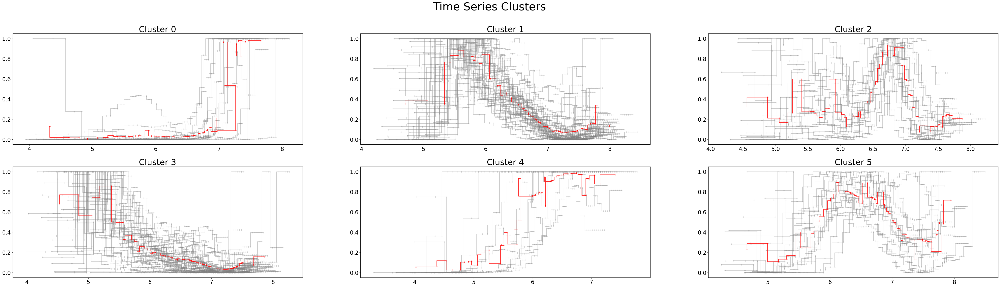

In [1363]:
# Best Models here
clusts6 = "clusts_6_batches_100_trials_20_iter_cutoff_1_acc_cutoff_60_test_runs_100/accumulative/finalARI_test_dict_oldSeed999_Accumulative.pkl"

clusts6_ARI_test_dict = pickle.load(open(path+clusts6, "rb"))
clusts6_model = clusts6_ARI_test_dict[0.0][-2][6][999].km
clusts6_pred_labels_sorted = clusts6_model.predict(vals_sorted)
clusts6_key_label_dict = {keys_sorted[idx]: clusts6_pred_labels_sorted[idx]
                          for idx in range(len(clusts6_pred_labels_sorted))}
plot_cluster_table(cluster_table=False,
                   Msmc_clustering_obj=False,
                   cluster_label_dict=clusts6_key_label_dict,
                   cluster_ts_dict=translated_ts_dict_latin_keyed,
                   clusts = 6,
                   x_aspect = 64,
                   y_aspect = 8,
                   cols = 3,
                   plot_barycenters = True,
                   max_iter=5)

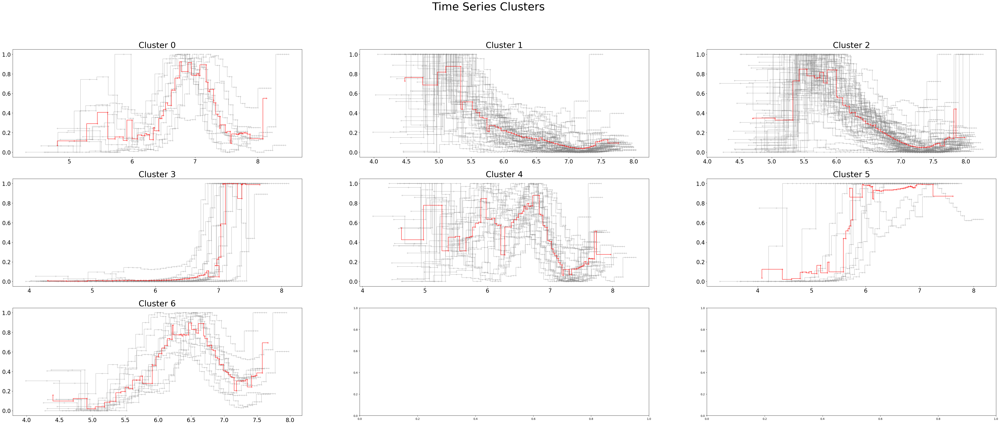

In [1366]:
clusts7 = "clusts_7_batches_100_trials_20_iter_cutoff_1_acc_cutoff_20_test_runs_100/accumulative/finalARI_test_dict_oldSeed999_Accumulative.pkl"

clusts7_ARI_test_dict = pickle.load(open(path+clusts7, "rb"))
clusts7_model = clusts7_ARI_test_dict[0.0][-2][7][999].km
clusts7_pred_labels_sorted = clusts7_model.predict(vals_sorted)
clusts7_key_label_dict = {keys_sorted[idx]: clusts7_pred_labels_sorted[idx]
                          for idx in range(len(clusts7_pred_labels_sorted))}
plot_cluster_table(cluster_table=False,
                   Msmc_clustering_obj=False,
                   cluster_label_dict=clusts7_key_label_dict,
                   cluster_ts_dict=translated_ts_dict_latin_keyed,
                   clusts = 7,
                   x_aspect = 64,
                   y_aspect = 8,
                   cols = 3,
                   plot_barycenters = True,
                   max_iter=5)

In [1577]:
translated_ts_dict_latin_keyed

{'Pteruthius_melanotis':             left_time_boundary  right_time_boundary    lambda
 time_index                                                   
 1                     4.289532             0.000028  0.889172
 2                     4.607920             0.000043  0.889172
 3                     4.801590             0.000060  0.889172
 4                     4.944329             0.000078  0.261302
 5                     5.059261             0.000098  0.261302
 ...                        ...                  ...       ...
 59                    7.382577             0.017827  1.000000
 60                    7.416948             0.019294  1.000000
 61                    7.451292             0.020881  1.000000
 62                    7.485617             0.022597  1.000000
 63                    7.519919                  inf  1.000000
 
 [63 rows x 3 columns],
 'Menura_novaehollandiae':             left_time_boundary  right_time_boundary    lambda
 time_index                               

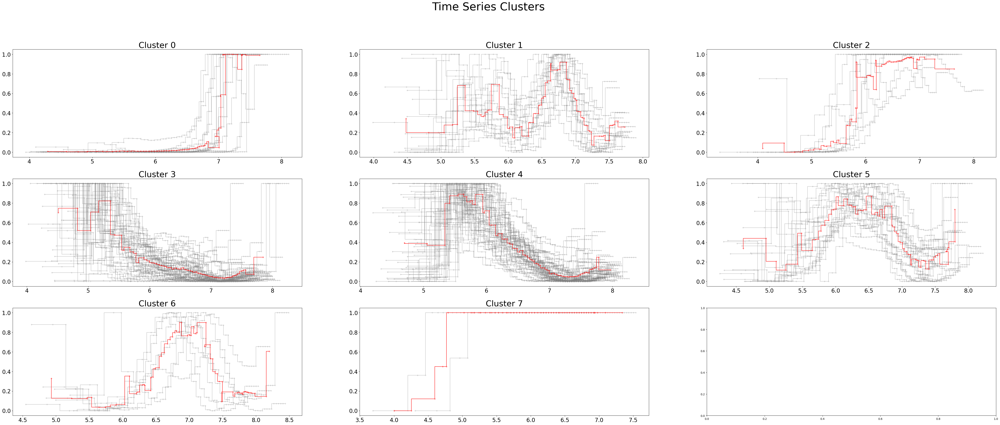

In [1362]:
clusts8 = "batches_100_trials_20_iter_cutoff_1_acc_cutoff_60_test_runs_100/accumulative/finalARI_test_dict_oldSeed999_Accumulative.pkl"

clusts8_ARI_test_dict = pickle.load(open(path+clusts8, "rb"))
clusts8_model = ARI_test_dict[0.0][-2][8][999].km
clusts8_pred_labels_sorted = clusts8_model.predict(vals_sorted)
clusts8_key_label_dict = {keys_sorted[idx]: clusts8_pred_labels_sorted[idx]
                          for idx in range(len(clusts8_pred_labels_sorted))}
plot_cluster_table(cluster_table=False,
                   Msmc_clustering_obj=False,
                   cluster_label_dict=clusts8_key_label_dict,
                   cluster_ts_dict=translated_ts_dict_latin_keyed,
                   clusts = 8,
                   x_aspect = 64,
                   y_aspect = 8,
                   cols = 3,
                   plot_barycenters = True,
                   max_iter=5)

In [250]:
import plotly.express as px
'''
Drop nares
'''
beak_cols = ["Beak.Length_Culmen", "Beak.Length_Nares", "Beak.Width", "Beak.Depth"]
beak_cols = ["Beak.Length_Culmen", "Beak.Width", "Beak.Depth"]
very_birdy = ["Beak.Length_Culmen", "Tarsus.Length", "Wing.Length", "Mass", "Tail.Length"]
very_birdy = ["Beak.Length_Culmen", "Tarsus.Length", "Wing.Length", "Tail.Length"]
very_birdy = ["Beak.Length_Culmen", "Beak.Width", "Beak.Depth", "Tarsus.Length", "Wing.Length", "Secondary1", "Tail.Length"]

# Find PCs
beak_pca, beak_data_dict = transform_pc(B10K_birds_avonet3_data,
                                feat_cols=beak_cols,
                                n_components=1)

body_pca, body_data_dict = transform_pc(B10K_birds_avonet3_data,
                                feat_cols=body_cols,
                                n_components=1)

misc_pca, misc_data_dict = transform_pc(B10K_birds_avonet3_data,
                                feat_cols=misc_cols,
                                n_components=1)

all_cols = beak_cols+body_cols+misc_cols
all_data = B10K_birds_avonet3_data[all_cols]
all_pca, all_data_dict = transform_pc(B10K_birds_avonet3_data,
                                feat_cols=all_cols,
                                n_components=2)

very_birdy_pca, very_birdy_dict = transform_pc(B10K_birds_avonet3_data,
                                feat_cols=very_birdy,
                                n_components=2)


# Start Plotting
# labels = np.array([key_label_dict[i] for i in sorted_keys])
labels = [str(key_label_dict[i]) for i in sorted_keys]
# Sort up some keys
sorted_keys = list(sorted(beak_data_dict.keys()))
# Vectorize my data in order of sorted_keys
beak_x = np.array([beak_data_dict[i][0] for i in sorted_keys])
body_x = np.array([body_data_dict[i][0] for i in sorted_keys])
misc_x = np.array([misc_data_dict[i][0] for i in sorted_keys])
all_data_pc1, all_data_pc2 = list(zip(*[all_data_dict[i].tolist() 
                                        for i in sorted_keys]))
very_birdy_pc1, very_birdy_pc2 = list(zip(*[very_birdy_dict[i].tolist() 
                                            for i in sorted_keys]))
df_custom_pcs = pd.DataFrame(data={"beak": beak_x,
                                   "body": body_x,
                                   "mass": misc_x,
                                   "Label": labels})
df_regular_pcs = pd.DataFrame(data={"PC1": all_data_pc1,
                                    "PC2": all_data_pc2,
                                    "Label": labels})
df_very_birdy_pcs = pd.DataFrame(data={"PC1": very_birdy_pc1,
                                    "PC2": very_birdy_pc2,
                                    "Label": labels})
px.scatter_3d(df_custom_pcs, x='beak', y='body', z='mass', color='Label')

# Make a PC with just beak features and another with Tarsus, wing length, and mass.

[0.95611062]
[467.45469932]
['Beak.Length_Culmen', 'Beak.Width', 'Beak.Depth']
[[0.970593   0.12478117 0.20586131]]

[0.83431235]
[2071.63150525]
['Tarsus.Length', 'Wing.Length', 'Kipps.Distance', 'Secondary1', 'Tail.Length']
[[0.21235337 0.70989546 0.27743022 0.4348871  0.42995368]]

[0.99970543]
[10688.90402644]
['Hand-Wing.Index', 'Mass']
[[0.00436765 0.99999046]]

[0.98297008 0.0099721 ]
[10845.32358611  1092.35993635]
['Beak.Length_Culmen', 'Beak.Width', 'Beak.Depth', 'Tarsus.Length', 'Wing.Length', 'Kipps.Distance', 'Secondary1', 'Tail.Length', 'Hand-Wing.Index', 'Mass']
[[ 0.0308144   0.00405447  0.00635065  0.04272055  0.12144502  0.04828276
   0.0734255   0.05989956  0.00437512  0.98543906]
 [ 0.10796874  0.02446273  0.04397422  0.06611041  0.54025428  0.14907111
   0.39558124  0.69811017  0.0157359  -0.15248995]]

[0.85115985 0.09698884]
[2028.43852651  684.7265411 ]
['Beak.Length_Culmen', 'Beak.Width', 'Beak.Depth', 'Tarsus.Length', 'Wing.Length', 'Secondary1', 'Tail.Length'

In [1042]:
path = "nick/MSMC-Curve-Analysis/MSMC-Exploratory-Analysis/bird-analysis/"

In [1064]:
bird_list

['Pteruthius_melanotis',
 'Menura_novaehollandiae',
 'Atrichornis_clamosus',
 'Nothoprocta_ornata',
 'Malurus_elegans',
 'Locustella_ochotensis',
 'Nothoprocta_pentlandii',
 'Illadopsis_cleaveri',
 'Cettia_vulcania',
 'Pycnonotus_atriceps',
 'Parus_atricapillus',
 'Callaeas_cinereus',
 'Grus_americana',
 'Panurus_biarmicus',
 'Crotophaga_sulcirostris',
 'Sylvia_atricapilla',
 'Rhegmatorhina_hoffmannsi',
 'Crypturellus_soui',
 'Pomatostomus_ruficeps',
 'Pachyramphus_minor',
 'Anseranas_semipalmata',
 'Sakesphorus_luctuosus',
 'Anhinga_rufa',
 'Dromas_ardeola',
 'Nicator_chloris',
 'Pachycephala_philippinensis',
 'Mystacornis_crossleyi',
 'Chloroceryle_aenea',
 'Rissa_tridactyla',
 'Myiagra_hebetior',
 'Upupa_epops',
 'Picathartes_gymnocephalus',
 'Scopus_umbretta',
 'Sagittarius_serpentarius',
 'Melanocharis_versteri',
 'Galbula_dea',
 'Pomatorhinus_ruficollis',
 'Zosterops_hypoxanthus',
 'Heliornis_fulica',
 'Bucco_capensis',
 'Dendroica_kirtlandii',
 'Thalassarche_chlororhynchos',
 'N

# Comparison of B10K MSMC Data to other MSMC Papers

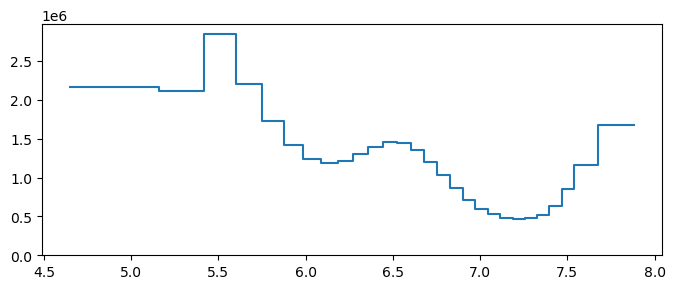

In [1061]:
# B10K_birds_avonet3_data.to_csv(path+"B10K_birds_avonet3_dataframe.csv")
def plot_ts_latin(latin, B10K_ts_dict_latin_keyed=B10K_ts_dict_latin_keyed):
    '''
    Can use:
    Normalized Dict: B10K_ts_dict_latin_keyed
    Unnormalized Dict: unnormalized_translated_ts_dict_latin_keyed
    '''
    xy_raw = B10K_ts_dict_latin_keyed[latin].drop(["right_time_boundary"],
                                                  axis=1).to_numpy()
    x, y = zip(*(xy_raw.tolist()))
    plt.figure(figsize=(8,3))
    plt.step(x, y)
    plt.ylim(0)
    plt.show()
    plt.close()


bird_list = list(B10K_birds_avonet3_data.index)

plot_ts_latin("Sylvia_atricapilla", unnormalized_translated_ts_dict_latin_keyed)

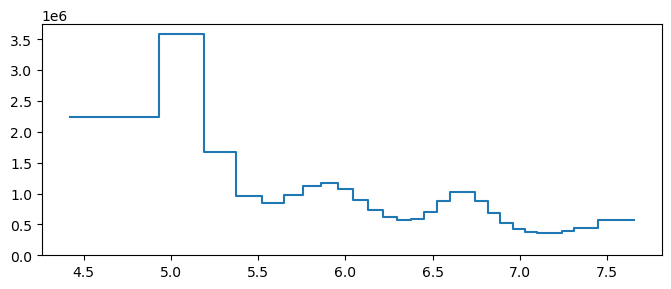

In [1065]:
plot_ts_latin("Zosterops_hypoxanthus", unnormalized_translated_ts_dict_latin_keyed)


['Beak.Length_Culmen', 'Beak.Width', 'Beak.Depth', 'Tarsus.Length', 'Wing.Length', 'Kipps.Distance', 'Secondary1', 'Tail.Length', 'Hand-Wing.Index', 'Mass']


Text(0, 0.5, 'PC2')

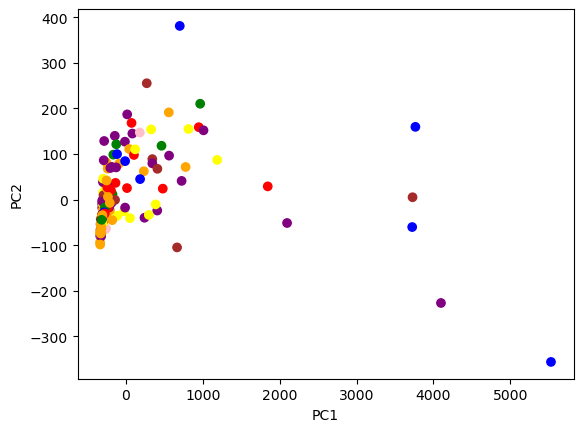

In [248]:
print(all_cols)
colors = ['red', 'green', 'blue', 'orange', 'purple', 'yellow', 'brown', 'pink']
label_colors = [colors[int(i)] for i in df_regular_pcs["Label"]]
plt.scatter(df_regular_pcs["PC1"],
            df_regular_pcs["PC2"],
            c = label_colors)
plt.xlabel("PC1")
plt.ylabel("PC2")

['Beak.Length_Culmen', 'Beak.Width', 'Beak.Depth', 'Tarsus.Length', 'Wing.Length', 'Secondary1', 'Tail.Length']


Text(0, 0.5, 'PC2')

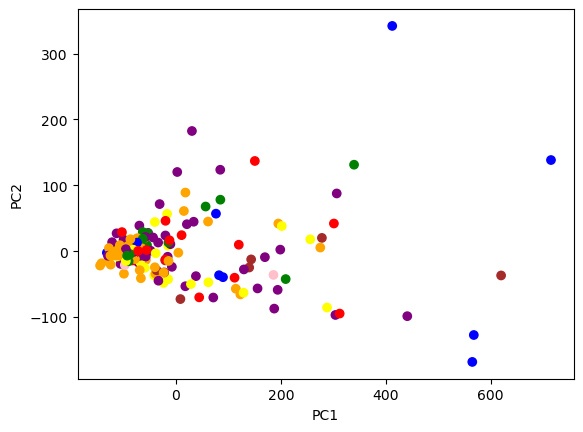

In [251]:
'''
Using mass causes PC1 to explain 98%. Mass is heavily weighted in PC1 too, making
it pretty much identical to the PCA on all regular bird features. Getting
'''
print(very_birdy)
colors = ['red', 'green', 'blue', 'orange', 'purple', 'yellow', 'brown', 'pink']
label_colors = [colors[int(i)] for i in df_regular_pcs["Label"]]
plt.scatter(df_very_birdy_pcs["PC1"],
            df_very_birdy_pcs["PC2"],
            c = label_colors)
plt.xlabel("PC1")
plt.ylabel("PC2")

In [ ]:
ct = 0
for pc in all_pca.components_.tolist():
    ct += 1
    print(f"PC{ct} explained variance: {all_pca.explained_variance_ratio_[ct-1]}")
    for idx, feat in enumerate(pc):
        print(f"{all_cols[idx]}: {feat}")
    print()

In [184]:
list(all_data_dict.items())[0]

('Pteruthius_melanotis', array([-325.17826149,  -70.7673558 ]))

/tmp/ipykernel_1932437/1357639464.py:5: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.



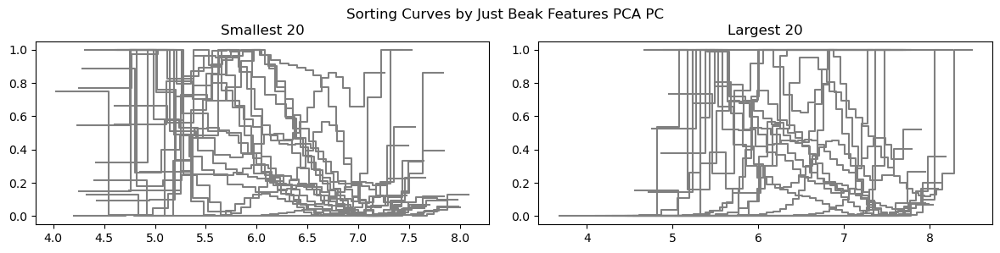

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

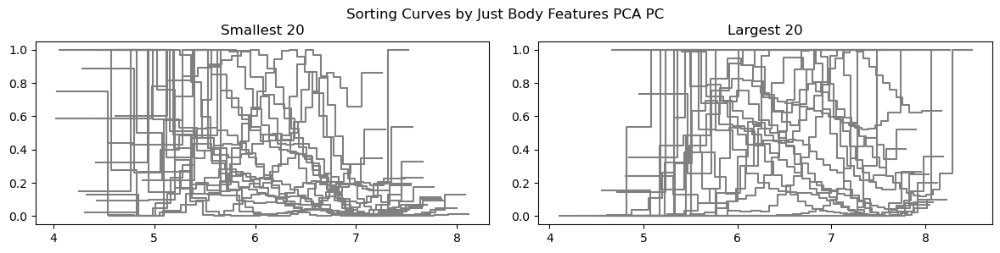

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

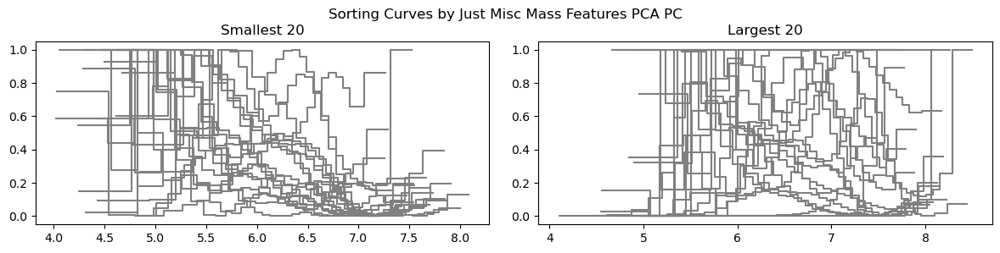

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

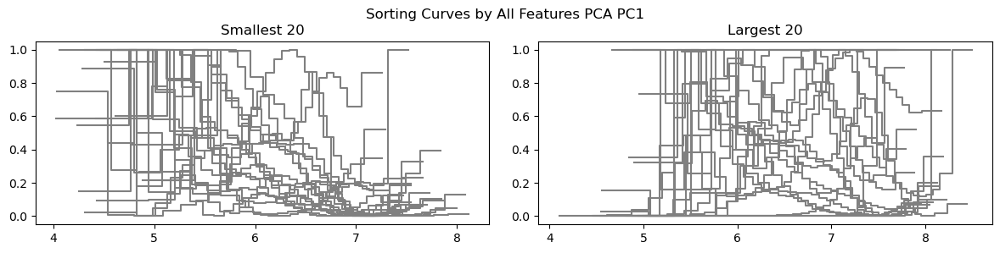

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

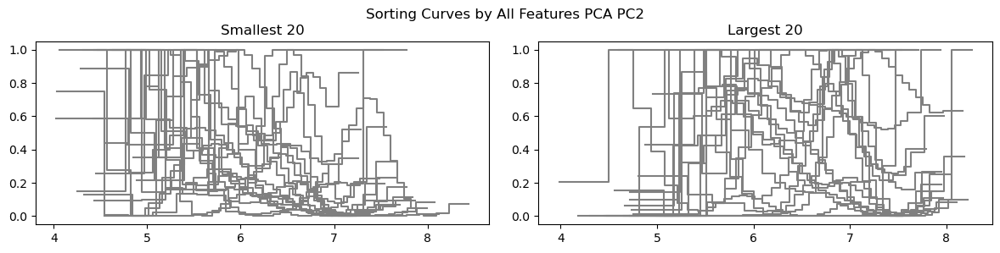

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

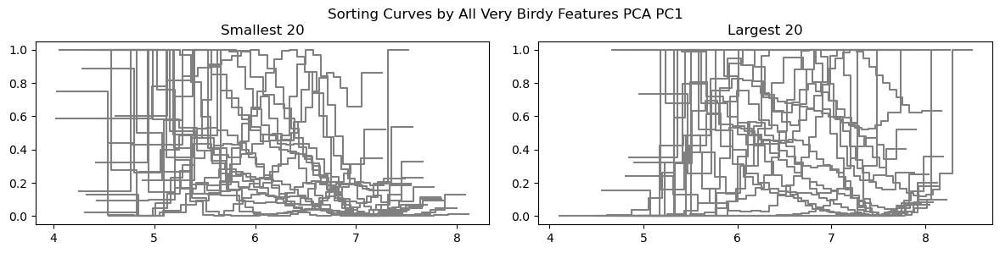

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

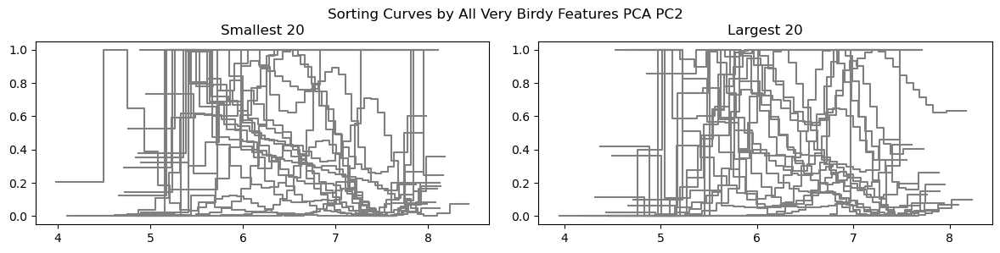

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

In [284]:
'''
Next thing to try is to sort ts data points by tranformed data

Try the PCA with Erik's selected features
    - Try doing the same sorting by PC value + Plotting
    - Might want to plot untransformed data (real time still)
        - Yeah we cluster with normalization, but lets see it without norming
    
'''
# Separateley computed PCs
sorted_beak_items = [i[0] for i in sorted(list(beak_data_dict.items()), key=lambda x:x[1])]
sorted_body_items = [i[0] for i in sorted(list(body_data_dict.items()), key=lambda x:x[1])]
sorted_misc_items = [i[0] for i in sorted(list(misc_data_dict.items()), key=lambda x:x[1])]
# Regularly computed 2 PCs
sorted_pc1_items  = [i[0] for i in sorted(list(all_data_dict.items()), key=lambda x:x[1][0])]
sorted_pc2_items  = [i[0] for i in sorted(list(all_data_dict.items()), key=lambda x:x[1][1])]
# Very birdy 2 PCs
sorted_very_birdy_pc1_items  = [i[0] for i in sorted(list(very_birdy_dict.items()), key=lambda x:x[1][0])]
sorted_very_birdy_pc2_items  = [i[0] for i in sorted(list(very_birdy_dict.items()), key=lambda x:x[1][1])]

num = 20
a = plot_ts_by_sorted_items(num=num,
                        sorted_list=sorted_beak_items,
                        translated_ts_dict_latin_keyed=translated_ts_dict_latin_keyed,
                        feature_title="Sorting Curves by Just Beak Features PCA PC")

b = plot_ts_by_sorted_items(num=num,
                        sorted_list=sorted_body_items,
                        translated_ts_dict_latin_keyed=translated_ts_dict_latin_keyed,
                        feature_title="Sorting Curves by Just Body Features PCA PC")

c = plot_ts_by_sorted_items(num=num,
                        sorted_list=sorted_misc_items,
                        translated_ts_dict_latin_keyed=translated_ts_dict_latin_keyed,
                        feature_title="Sorting Curves by Just Misc Mass Features PCA PC")

d = plot_ts_by_sorted_items(num=num,
                        sorted_list=sorted_pc1_items,
                        translated_ts_dict_latin_keyed=translated_ts_dict_latin_keyed,
                        feature_title="Sorting Curves by All Features PCA PC1")

e = plot_ts_by_sorted_items(num=num,
                        sorted_list=sorted_pc2_items,
                        translated_ts_dict_latin_keyed=translated_ts_dict_latin_keyed,
                        feature_title="Sorting Curves by All Features PCA PC2")

f = plot_ts_by_sorted_items(num=num,
                        sorted_list=sorted_very_birdy_pc1_items,
                        translated_ts_dict_latin_keyed=translated_ts_dict_latin_keyed,
                        feature_title="Sorting Curves by All Very Birdy Features PCA PC1")

g = plot_ts_by_sorted_items(num=num,
                        sorted_list=sorted_very_birdy_pc2_items,
                        translated_ts_dict_latin_keyed=translated_ts_dict_latin_keyed,
                        feature_title="Sorting Curves by All Very Birdy Features PCA PC2")

In [285]:
unnormalized_name2series = unnormalized_msmc_obj.name2series
unnormalized_name2series_raw = {i[:i.index("_GC")]: unnormalized_name2series[i] for i in unnormalized_name2series.keys()}
unnormalized_name2series_translated = {B10K_avonet_translation[i] if i in B10K_avonet_translation else i: 
                                       unnormalized_name2series_raw[i]
                                       for i in unnormalized_name2series_raw.keys()}
# I'm gonna need to translate this series
unnormalized_name2series_translated

{'Casuarius_casuarius':             left_time_boundary  right_time_boundary        lambda
 time_index                                                       
 1                     4.715520             0.000012  5.094232e+04
 2                     5.033905             0.000019  5.094232e+04
 3                     5.227577             0.000027  5.094232e+04
 4                     5.370316             0.000035  1.318834e+05
 5                     5.485249             0.000044  1.318834e+05
 ...                        ...                  ...           ...
 59                    7.808564             0.008029  2.622329e+08
 60                    7.842935             0.008690  2.622329e+08
 61                    7.877281             0.009405  2.622329e+08
 62                    7.911604             0.010178  2.622329e+08
 63                    7.945905                  inf  2.622329e+08
 
 [63 rows x 3 columns],
 'Loxia_curvirostra':             left_time_boundary  right_time_boundary       

Smallest Few Labels:  [4, 3, 3, 0, 4, 5, 3, 3, 3, 3, 3, 2, 3, 3, 3, 4, 4, 4, 4, 3]
Largest Few Labels:  [4, 2, 0, 4, 5, 2, 4, 0, 7, 5, 4, 4, 3, 1, 0, 3, 0, 2, 2, 6]


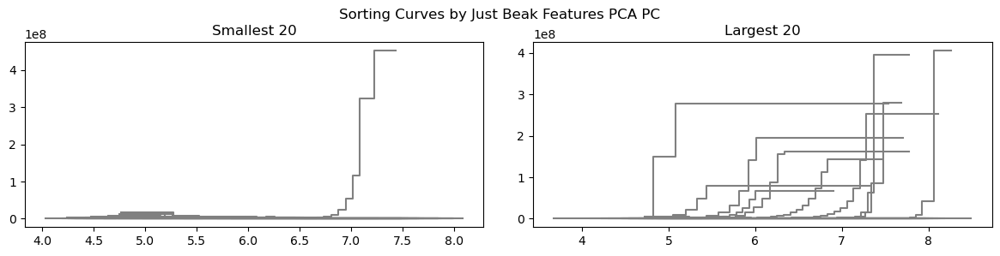

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

Smallest Few Labels:  [3, 3, 2, 5, 4, 3, 3, 3, 3, 3, 4, 3, 3, 3, 1, 3, 4, 4, 5, 3]
Largest Few Labels:  [4, 7, 5, 1, 4, 3, 5, 4, 0, 6, 4, 1, 5, 0, 2, 4, 2, 6, 2, 2]


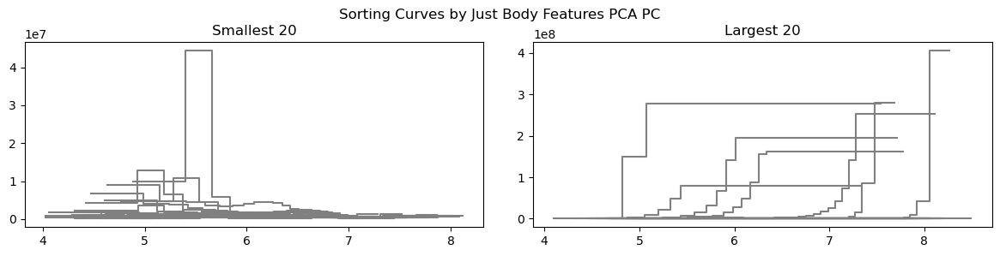

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

Smallest Few Labels:  [3, 3, 3, 2, 3, 3, 3, 3, 3, 4, 3, 4, 3, 4, 5, 4, 3, 3, 3, 3]
Largest Few Labels:  [1, 0, 3, 4, 2, 6, 4, 3, 5, 0, 1, 4, 5, 0, 4, 2, 6, 2, 4, 2]


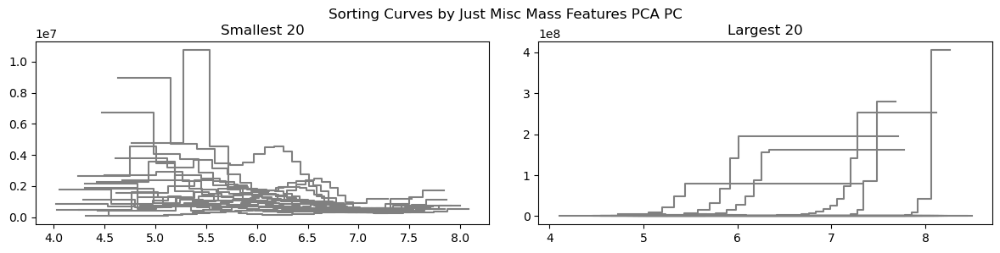

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

Smallest Few Labels:  [3, 3, 3, 2, 3, 3, 3, 4, 4, 3, 3, 5, 3, 3, 4, 5, 3, 3, 3, 3]
Largest Few Labels:  [1, 0, 3, 4, 6, 2, 4, 3, 5, 0, 1, 4, 5, 0, 4, 2, 6, 2, 4, 2]


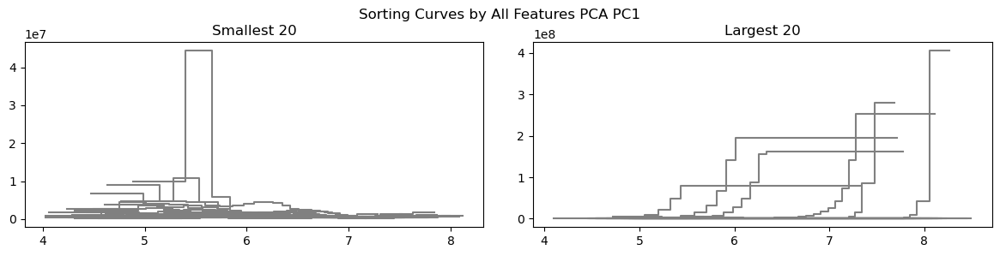

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

Smallest Few Labels:  [2, 4, 6, 3, 3, 4, 3, 2, 5, 3, 3, 3, 3, 3, 3, 3, 4, 3, 1, 3]
Largest Few Labels:  [5, 3, 1, 1, 4, 4, 4, 4, 7, 4, 5, 5, 0, 2, 0, 4, 3, 1, 6, 2]


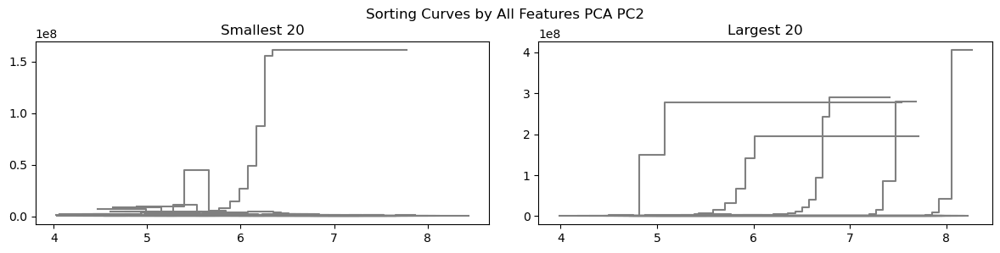

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

Smallest Few Labels:  [3, 3, 2, 4, 5, 3, 3, 3, 3, 3, 4, 3, 3, 1, 3, 4, 3, 4, 3, 5]
Largest Few Labels:  [4, 3, 4, 5, 1, 5, 3, 6, 5, 0, 4, 4, 0, 1, 2, 4, 2, 2, 6, 2]


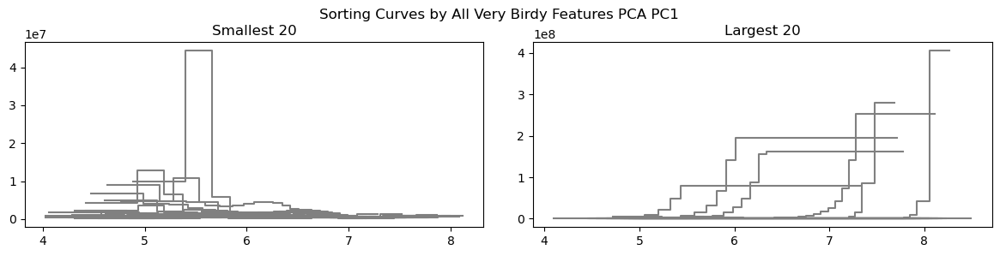

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

Smallest Few Labels:  [2, 2, 4, 4, 0, 4, 5, 6, 4, 0, 3, 5, 4, 3, 4, 4, 5, 5, 5, 4]
Largest Few Labels:  [0, 5, 4, 3, 0, 5, 2, 3, 1, 4, 1, 4, 3, 4, 4, 1, 0, 2, 4, 2]


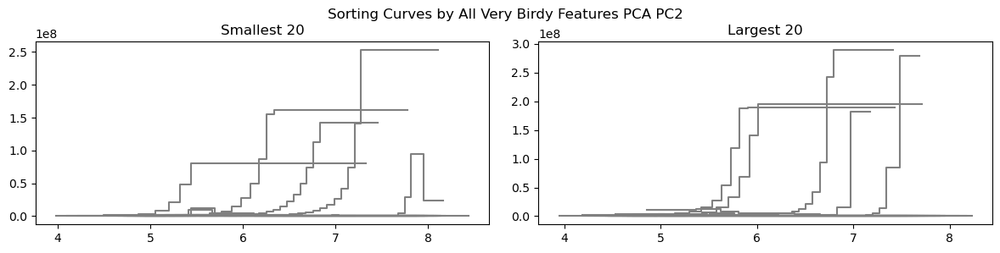

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

In [306]:
'''
Next thing to try is to sort ts data points by tranformed data

Try the PCA with Erik's selected features
    - Try doing the same sorting by PC value + Plotting
    - Might want to plot untransformed data (real time still)
        - Yeah we cluster with normalization, but lets see it without norming
    
'''
# Separateley computed PCs
sorted_beak_items = [i[0] for i in sorted(list(beak_data_dict.items()), key=lambda x:x[1])]
sorted_body_items = [i[0] for i in sorted(list(body_data_dict.items()), key=lambda x:x[1])]
sorted_misc_items = [i[0] for i in sorted(list(misc_data_dict.items()), key=lambda x:x[1])]
# Regularly computed 2 PCs
sorted_pc1_items  = [i[0] for i in sorted(list(all_data_dict.items()), key=lambda x:x[1][0])]
sorted_pc2_items  = [i[0] for i in sorted(list(all_data_dict.items()), key=lambda x:x[1][1])]
# Very birdy 2 PCs
sorted_very_birdy_pc1_items  = [i[0] for i in sorted(list(very_birdy_dict.items()), key=lambda x:x[1][0])]
sorted_very_birdy_pc2_items  = [i[0] for i in sorted(list(very_birdy_dict.items()), key=lambda x:x[1][1])]

unnormalized_translated_ts_dict_latin_keyed = unnormalized_name2series_translated
num = 20
a = plot_ts_by_sorted_items(num=num,
                            sorted_list=sorted_beak_items,
                            translated_ts_dict_latin_keyed=unnormalized_translated_ts_dict_latin_keyed,
                            key_label_dict=key_label_dict,
                            feature_title="Sorting Curves by Just Beak Features PCA PC")

b = plot_ts_by_sorted_items(num=num,
                            sorted_list=sorted_body_items,
                            translated_ts_dict_latin_keyed=unnormalized_translated_ts_dict_latin_keyed,
                            key_label_dict=key_label_dict,
                            feature_title="Sorting Curves by Just Body Features PCA PC")

c = plot_ts_by_sorted_items(num=num,
                            sorted_list=sorted_misc_items,
                            translated_ts_dict_latin_keyed=unnormalized_translated_ts_dict_latin_keyed,
                            key_label_dict=key_label_dict,
                            feature_title="Sorting Curves by Just Misc Mass Features PCA PC")

d = plot_ts_by_sorted_items(num=num,
                            sorted_list=sorted_pc1_items,
                            translated_ts_dict_latin_keyed=unnormalized_translated_ts_dict_latin_keyed,
                            key_label_dict=key_label_dict,
                            feature_title="Sorting Curves by All Features PCA PC1")

e = plot_ts_by_sorted_items(num=num,
                            sorted_list=sorted_pc2_items,
                            translated_ts_dict_latin_keyed=unnormalized_translated_ts_dict_latin_keyed,
                            key_label_dict=key_label_dict,
                            feature_title="Sorting Curves by All Features PCA PC2")

f = plot_ts_by_sorted_items(num=num,
                            sorted_list=sorted_very_birdy_pc1_items,
                            translated_ts_dict_latin_keyed=unnormalized_translated_ts_dict_latin_keyed,
                            key_label_dict=key_label_dict,
                            feature_title="Sorting Curves by All Very Birdy Features PCA PC1")

g = plot_ts_by_sorted_items(num=num,
                            sorted_list=sorted_very_birdy_pc2_items,
                            translated_ts_dict_latin_keyed=unnormalized_translated_ts_dict_latin_keyed,
                            key_label_dict=key_label_dict,
                            feature_title="Sorting Curves by All Very Birdy Features PCA PC2")

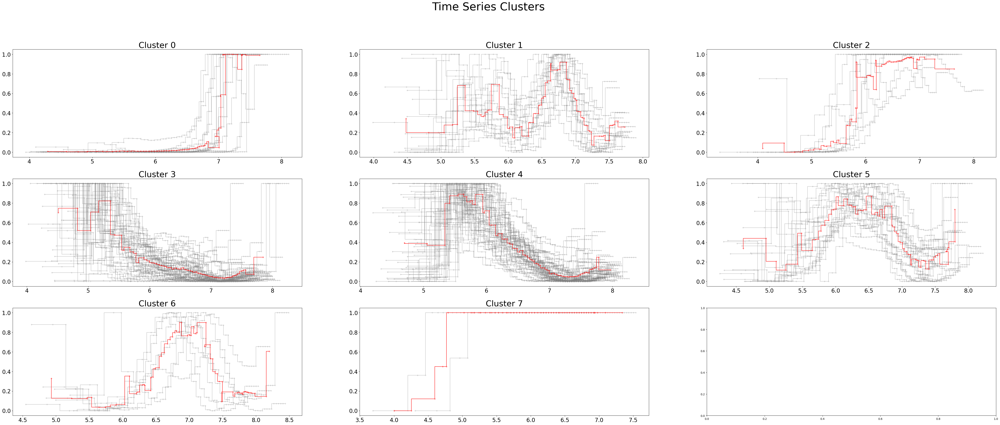

In [290]:
plot_cluster_table(cluster_table=False,
                   Msmc_clustering_obj=False,
                   cluster_label_dict=key_label_dict,
                   cluster_ts_dict=translated_ts_dict_latin_keyed,
                   clusts = 8,
                   x_aspect = 64,
                   y_aspect = 8,
                   cols = 3,
                   plot_barycenters = True,
                   max_iter=5)

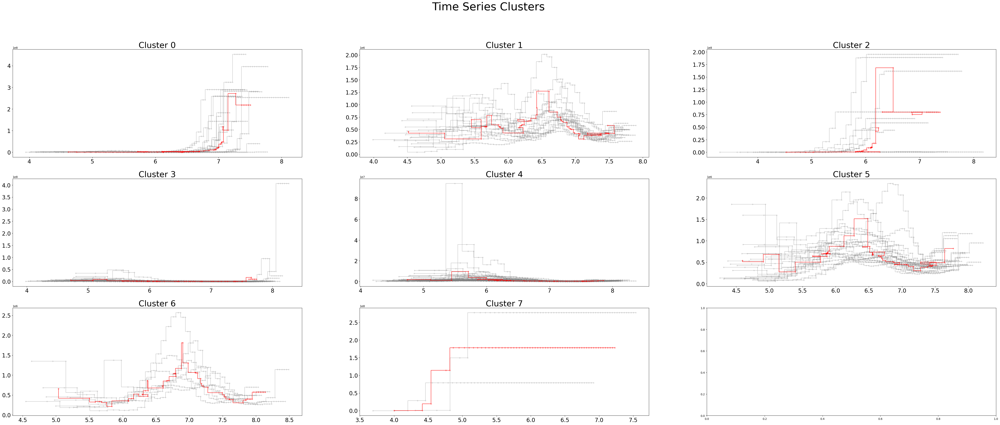

In [287]:
plot_cluster_table(cluster_table=False,
                   Msmc_clustering_obj=False,
                   cluster_label_dict=key_label_dict,
                   cluster_ts_dict=unnormalized_translated_ts_dict_latin_keyed,
                   clusts = 8,
                   x_aspect = 64,
                   y_aspect = 8,
                   cols = 3,
                   plot_barycenters = True,
                   max_iter=5)

In [1456]:
from pyts.classification import LearningShapelets
from pyts.datasets import load_gunpoint
from pyts.utils import windowed_view
from pyts.transformation import ShapeletTransform
from sklearn.pipeline import make_pipeline
from sklearn.svm import LinearSVC

# tslearn Shapelet Lib

In [1516]:
def plot_shapelet(
                  num_ts_to_plot,
                  shp_clf,
                  ts_data,
                  plot_n_best_shaps=True,
                  ts_id_to_plot=[]):
    '''
    ts_id_to_plot: Specific index of ts to plot
    num_ts_to_plot: Number of ts to plot
    shp_clf
    ts_data
    plot_n_best_shaps: Number of best shapelets to plot, by default, plots all
    shapelets
    '''
    assert isinstance(ts_id_to_plot, list)
    predicted_locations = shp_clf.locate(ts_data) # Compute shapelet match location for each ts in ts_data
    distances_raw = shp_clf.transform(ts_data) # Distances of shapelet to ts_data
    # Plot ts from num_ts_to_plot
    range_list = list(range(num_ts_to_plot))
    iter_list = ts_id_to_plot + range_list
    for test_ts_id in iter_list:
        f, ax = plt.subplots(2, 1, sharex=True)
        ordered_shap_indices = np.argsort(distances_raw[test_ts_id]) # List of indices of shapelets sorted in descending order based on shapelet distance
        if plot_n_best_shaps == True:
            print("hmm thats a lota shapes")
            plot_n_best_shaps = len(ordered_shap_indices)
        
        if len(ts_data.shape) == 3: # Unevenly spaced time series
            x_pts, y_pts = zip(*ts_data[test_ts_id].tolist()) 
            ax[0].step(x_pts, y_pts, color="black")
        elif len(ts_data.shape) == 2: # Evenly spaced time series
            x_pts = ts_data[test_ts_id]
            ax[0].plot(ts_data[test_ts_id],'-.', color="black")
        for shapelet_idx in ordered_shap_indices[:plot_n_best_shaps]: # Iterate over best fitted shapelets
            # shapelet_idx might be used as a key or "name" for each shapelet
            shap_raw = shp_clf.shapelets_[shapelet_idx] # np.arr containing all our shapelets. Shape: (num shapelets,)
            pos = predicted_locations[test_ts_id, shapelet_idx] # Index in timeseries (x_pts) where shap begins
            if len(ts_data.shape) == 3: # Unevenly spaced time series
                shap_x_raw, shap_y_raw = zip(*shap_raw.tolist())
                shap = np.array(list(zip(shap_x_raw, shap_y_raw)))
                pos_time = x_pts[pos] # Beginning location of shap
                # Plot shapelet
                x_shap, y_shap = zip(*shap.tolist())
                x_shap_offset = x_shap[0] - pos_time
                x_shap = np.array(x_shap) - x_shap_offset
                ax[0].step(x_shap, y_shap, linewidth=2)
            elif len(ts_data.shape) == 2: # Evenly spaced time series
                # Plot shapelet
                pos_time = pos
                shap_offset = shap_raw[0] - pos_time
                shap = np.array(shap_raw)
                ax[0].plot(np.arange(pos, pos + len(shap)), shap,'-.', linewidth=2)
            ax[0].axvline(pos_time, color='k', linestyle='--', alpha=0.25)
            ax[0].set_title(f"Shapelet {shapelet_idx} aligned on tsid {test_ts_id}")
            # We calculate the distances from the shapelet to the timeseries ourselves.
            distances = []
            times = []
            time_series = ts_data[test_ts_id]
            for i in range(len(time_series) - len(shap) + 1): # Iterate over windows
                dist = np.linalg.norm(time_series[i:i+len(shap)] - shap)
                x_loc = x_pts[i] if len(ts_data.shape) == 3 else i
                distances.append(dist)
                times.append(x_loc)
            # ax[1].plot(distances)
            ax[1].plot(times, distances)
            ax[1].axvline(pos_time, color='k', linestyle='--', alpha=0.25)
            ax[1].set_title('The distances between the time series and the shapelet')
        plt.tight_layout()
        plt.show()
#         plt.close()

def create_uniform_tts(N,
                       X,
                       y, 
                       random_state=42):
    '''
    Uniformly splites data into training and testing sets (Use with SVM, not
    shp_clf! shp_clf is meant for extracting features from X. SVM is used to
    classify X data using their extracted features, therefore train-test-split
    is necessary)
    '''
    np.random.seed(random_state)
    # START UTTS
    classes = set(y)
    # Form class_label_index_dict
    class_label_ts_dict = {clabel: [] for clabel in classes}
    for idx, label in enumerate(y):
        class_label_ts_dict[label].append(X[idx]) # Add data to class dict
    # Create training set by randomly sampling from class_label_ts_dict
    X_train = []
    X_test = []
    y_train = []
    y_test = []
    for label in classes:
        ts = class_label_ts_dict[label] # List of ts corresponding to class
        if N <= len(ts):
            X_train += ts[:N]
            X_test  += ts[N:]
            y_train += [label]*N
            y_test += [label]*len(ts[N:])
        else: # In the case we get a super small cluster, I'll take what I can get
            X_train += ts   
            X_test += ts
            y_train += [label]*len(ts)  
            y_test +=  [label]*len(ts)  
    # Shuffle training data!!!
    Xy_train = list(zip(X_train, y_train))
    Xy_test = list(zip(X_test, y_test))
    np.random.shuffle(Xy_train) # Shuffle list of Xy pairs
    np.random.shuffle(Xy_test)
    X_train, y_train = zip(*Xy_train)
    X_test, y_test = zip(*Xy_test)
    return (X_train, X_test, y_train, y_test)
                               
def create_shp_svm_clf(N,
                       X,
                       y,
                       shapelet_sizes={10:8, 30:8, 50: 8},
                       random_state=42,
                       uniform=True,
                       test_size=0.8,
                       lr=0.01,
                       weight_regularizer=0.001,
                       max_iter=10):
    
    '''
    N: Number of classes (cluster labels in y)
    X: time series data
    y: Cluster labels for each time series in X
    shapelet_sizes: {length to make shapelet: number of shapelets to make for shp_clf}
    random_state: Random seed to use, random states are used for LearningShapelets and data splitting
    uniform: If true, use my create_uniform_tts function to split data, else use sklearn train_test_split
    test_size: If using sklearn train_test_split, you can set proportion of data to train on (default 20% training)
    
    Function rundown: We want to make a classifier on features extracted from 
    timeseries data.
    
    Part 1: Making shp_clf to extract features
    On all data X, y, extract a bunch of shapelets (our extracted features).
    
    Part 2: Making svm on extracted features
    Splits X,y data into training and testing data. With split data, function 
    trains shapelet classifier (LearningShapelets from sklearn). With our
    extracted shapelets, we make an SVM classifier
    '''
    from sklearn.model_selection import train_test_split
    np.random.seed(random_state)
    # Define the model and fit it using the training data
    shp_clf = LearningShapelets(n_shapelets_per_size=shapelet_sizes,
                                weight_regularizer=weight_regularizer,
                                optimizer=Adam(lr=lr),
                                max_iter=max_iter,
                                verbose=1,
                                scale=False,
                                random_state=random_state)
    # Add data splitting here!
    if uniform:
        X_train, X_test, y_train, y_test = create_uniform_tts(N, X, y,
                                                              random_state=random_state)
    else:
        X_train, X_test, y_train, y_test = train_test_split(X,
                                                            y,
                                                            test_size=test_size,
                                                            random_state=random_state)  
    # Fitting should work on X_train too: (183, 63, 2)
    X_train_shapelet = shp_clf.fit_transform(X_train, y_train) # Extracted features
    shp_acc = shp_clf.score(X_test, y_test)
    # Make SVM Clf based on extracted features from shp_clf
    from sklearn.svm import LinearSVC
    # Extract shapelet features for the training and testing data
    X_test_shapelet = shp_clf.transform(X_test)
    svm = LinearSVC()
    svm.fit(X_train_shapelet, y_train)
    svm_acc = svm.score(X_test_shapelet, y_test)
    setting = "uniform" if uniform else f"{np.round(test_size*100)}/{(1-test_size)*100}"
    print(f"Accuracy of SHP clf", setting, f"split: {shp_acc}")
    print(f"Accuracy of SVM clf", setting, f"split: {svm_acc}")
    
    return (shp_clf, svm)


In [1458]:
# Load in modules, data, and keys
from tslearn.datasets import CachedDatasets
from tslearn.preprocessing import TimeSeriesScalerMinMax
from tslearn.shapelets import LearningShapelets, \
    grabocka_params_to_shapelet_size_dict
from tensorflow.keras.optimizers import Adam

latin_name_keys = list(key_label_dict.keys()) # All data in order of latin_name_keys
# Load in normalized x data
x_timeseries = np.array([translated_ts_dict_latin_keyed[i].drop(["right_time_boundary"], axis=1,) 
                         for i in latin_name_keys]) 
X_train_raw = np.array([translated_ts_dict_latin_keyed[i]["left_time_boundary"] 
                         for i in latin_name_keys])
x_ne = np.array([translated_ts_dict_latin_keyed[i]["lambda"] 
                 for i in latin_name_keys])
# Load in unnormalized x data
x_unnormalized_timeseries = np.array([unnormalized_translated_ts_dict_latin_keyed[i]
                                      for i in latin_name_keys])
x_unnormalized_ne = np.array([unnormalized_translated_ts_dict_latin_keyed[i]["lambda"] 
                 for i in latin_name_keys])
# Load in labels data
y_labels = np.array([key_label_dict[i] for i in latin_name_keys])
y_train = y_labels

# Transform data to cater towards tslearn
X_train_timestamps = np.squeeze(TimeSeriesScalerMinMax().fit_transform(X_train_raw))
X_train_ne = np.squeeze(TimeSeriesScalerMinMax().fit_transform(x_ne))
# This X_train normalizes both time and ne
X_train = []
for idx in range(len(X_train_timestamps)):
    series_time = X_train_timestamps[idx].tolist()
    series_ne = X_train_ne[idx].tolist()
    series_pair = np.array(list(zip(series_time, series_ne)))
    X_train.append(series_pair)
X_train = np.array(X_train)


### Creating SVM Classifier on found shapelets

## Evaluate Shapelets with an SVM Clf on 20/80 split

In [1296]:
from sklearn.model_selection import train_test_split
# Get statistics of the dataset
N = len(set(y_train)) # Like 8 classes
X = X_train
y = y_train
# We will extract 1 shapelet and align it with a time series
shapelet_sizes = {7:20, 14:20, 21: 20} # Setting for 9 shapelets of sizes 7, 14, and 21 

# Define the model and fit it using the training data
shp_clf_2080, svm_2080 = create_shp_svm_clf(N,
                                            X,
                                            y,
                                            shapelet_sizes=shapelet_sizes,
                                            random_state=42,
                                            uniform=False,
                                            test_size=0.8)


/home/nick/miniconda3/envs/stats/lib/python3.9/site-packages/keras/optimizers/optimizer_v2/adam.py:110: UserWarning:

The `lr` argument is deprecated, use `learning_rate` instead.

/home/nick/miniconda3/envs/stats/lib/python3.9/site-packages/tslearn/shapelets/shapelets.py:354: FutureWarning:

The default value for 'scale' is set to False in version 0.4 to ensure backward compatibility, but is likely to change in a future version.



Epoch 1/10
1/1 [==============================] - 2s 2s/step - loss: 1.8347 - categorical_accuracy: 0.2778 - categorical_crossentropy: 1.8239
Epoch 2/10
1/1 [==============================] - 0s 11ms/step - loss: 1.7363 - categorical_accuracy: 0.2778 - categorical_crossentropy: 1.7255
Epoch 3/10
1/1 [==============================] - 0s 11ms/step - loss: 1.6518 - categorical_accuracy: 0.2778 - categorical_crossentropy: 1.6408
Epoch 4/10
1/1 [==============================] - 0s 10ms/step - loss: 1.5807 - categorical_accuracy: 0.2778 - categorical_crossentropy: 1.5695
Epoch 5/10
1/1 [==============================] - 0s 10ms/step - loss: 1.5214 - categorical_accuracy: 0.2778 - categorical_crossentropy: 1.5100
Epoch 6/10
1/1 [==============================] - 0s 9ms/step - loss: 1.4723 - categorical_accuracy: 0.2778 - categorical_crossentropy: 1.4607
Epoch 7/10
1/1 [==============================] - 0s 9ms/step - loss: 1.4316 - categorical_accuracy: 0.3056 - categorical_crossentropy: 1.4

## Evaluate Shapelets with an SVM Clf on 33/66 split

In [1295]:
shp_clf_3366, svm_3366 = create_shp_svm_clf(N,
                                            X,
                                            y,
                                            shapelet_sizes=shapelet_sizes,
                                            random_state=42,
                                            uniform=False,
                                            test_size=0.66)


/home/nick/miniconda3/envs/stats/lib/python3.9/site-packages/keras/optimizers/optimizer_v2/adam.py:110: UserWarning:

The `lr` argument is deprecated, use `learning_rate` instead.

/home/nick/miniconda3/envs/stats/lib/python3.9/site-packages/tslearn/shapelets/shapelets.py:354: FutureWarning:

The default value for 'scale' is set to False in version 0.4 to ensure backward compatibility, but is likely to change in a future version.



Epoch 1/10
1/1 [==============================] - 2s 2s/step - loss: 2.1629 - categorical_accuracy: 0.0806 - categorical_crossentropy: 2.1491
Epoch 2/10
1/1 [==============================] - 0s 13ms/step - loss: 2.0585 - categorical_accuracy: 0.1935 - categorical_crossentropy: 2.0448
Epoch 3/10
1/1 [==============================] - 0s 12ms/step - loss: 1.9643 - categorical_accuracy: 0.3548 - categorical_crossentropy: 1.9504
Epoch 4/10
1/1 [==============================] - 0s 12ms/step - loss: 1.8804 - categorical_accuracy: 0.3548 - categorical_crossentropy: 1.8664
Epoch 5/10
1/1 [==============================] - 0s 13ms/step - loss: 1.8066 - categorical_accuracy: 0.3548 - categorical_crossentropy: 1.7924
Epoch 6/10
1/1 [==============================] - 0s 11ms/step - loss: 1.7427 - categorical_accuracy: 0.3548 - categorical_crossentropy: 1.7282
Epoch 7/10
1/1 [==============================] - 0s 12ms/step - loss: 1.6879 - categorical_accuracy: 0.3548 - categorical_crossentropy: 1

## Evaluate Shapelets with an SVM Clf on 50/50 split

In [1308]:
shp_clf_5050, svm_5050 = create_shp_svm_clf(N,
                                            X,
                                            y,
                                            shapelet_sizes=shapelet_sizes,
                                            random_state=42,
                                            uniform=False,
                                            test_size=0.5,
                                            lr=0.01,
                                            weight_regularizer=0.001,
                                            max_iter=10)
# The loss history is accessible via the `model_` that is a keras model
plt.figure()
plt.plot(numpy.arange(1, shp_clf_5050.n_iter_ + 1), shp_clf_5050.history_["loss"])
plt.title("Evolution of cross-entropy loss during training")
plt.xlabel("Epochs")
plt.show()

/home/nick/miniconda3/envs/stats/lib/python3.9/site-packages/keras/optimizers/optimizer_v2/adam.py:110: UserWarning:

The `lr` argument is deprecated, use `learning_rate` instead.

/home/nick/miniconda3/envs/stats/lib/python3.9/site-packages/tslearn/shapelets/shapelets.py:354: FutureWarning:

The default value for 'scale' is set to False in version 0.4 to ensure backward compatibility, but is likely to change in a future version.



Epoch 1/10
1/1 [==============================] - 2s 2s/step - loss: 2.0928 - categorical_accuracy: 0.2637 - categorical_crossentropy: 2.0790
Epoch 2/10
1/1 [==============================] - 0s 16ms/step - loss: 2.0015 - categorical_accuracy: 0.2637 - categorical_crossentropy: 1.9878
Epoch 3/10
1/1 [==============================] - 0s 15ms/step - loss: 1.9184 - categorical_accuracy: 0.2857 - categorical_crossentropy: 1.9046
Epoch 4/10
1/1 [==============================] - 0s 16ms/step - loss: 1.8436 - categorical_accuracy: 0.3077 - categorical_crossentropy: 1.8296
Epoch 5/10
1/1 [==============================] - 0s 16ms/step - loss: 1.7766 - categorical_accuracy: 0.3297 - categorical_crossentropy: 1.7623
Epoch 6/10
1/1 [==============================] - 0s 15ms/step - loss: 1.7168 - categorical_accuracy: 0.3516 - categorical_crossentropy: 1.7022
Epoch 7/10
1/1 [==============================] - 0s 16ms/step - loss: 1.6638 - categorical_accuracy: 0.4505 - categorical_crossentropy: 1

In [1309]:
shp_clf_5050._X_fit_dims

(91, 63, 2)

1/1 [==============================] - 0s 61ms/step


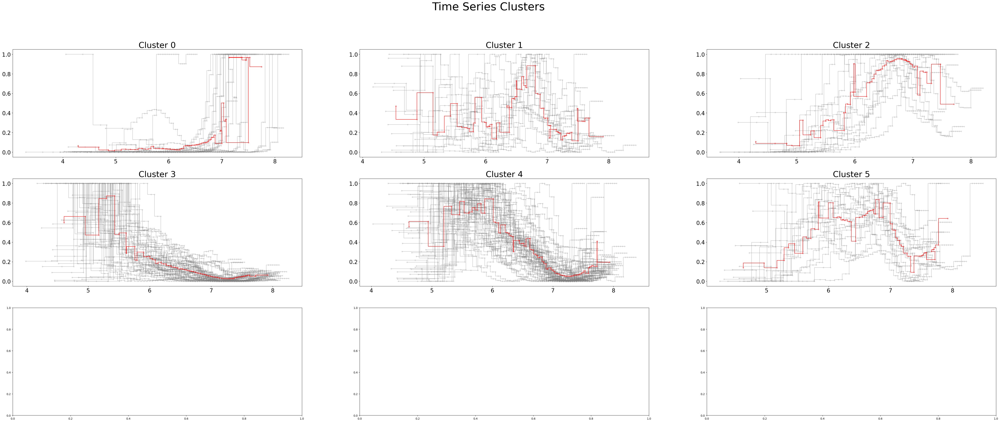

In [1317]:
'''
We have translated_ts_dict_latin_keyed, make key_label_dict from split test 
svm models trained on shapelet features.
'''
# Plot out time series on shapelet-determined groupings
svm_model = uniform_svm

X_train_shapelet_ALL = uniform_shp_clf.transform(X_train)
y_pred = svm_model.predict(X_train_shapelet_ALL)
shapelet_key_label_dict = dict()
for idx, latin_key in enumerate(latin_name_keys):
    y_pred_i = y_pred[idx]
    shapelet_key_label_dict[latin_key] = y_pred_i

plot_cluster_table(cluster_table=False,
                   Msmc_clustering_obj=False,
                   cluster_label_dict=shapelet_key_label_dict,
                   cluster_ts_dict=translated_ts_dict_latin_keyed,
                   clusts = 8,
                   x_aspect = 64,
                   y_aspect = 8,
                   cols = 3,
                   plot_barycenters = True,
                   max_iter=5)

## Uniform train-test split function

Due to very non uniform distribution of data among clusters, I should randomly sample N random time series from each of my K clusters. This might reduce overfitting as well as improving shapelet diversity.

Might also try increasing regularizer param to reduce overfitting

### Pretty decent settings

/home/nick/miniconda3/envs/stats/lib/python3.9/site-packages/keras/optimizers/optimizer_v2/adam.py:110: UserWarning:

The `lr` argument is deprecated, use `learning_rate` instead.

/home/nick/miniconda3/envs/stats/lib/python3.9/site-packages/tslearn/shapelets/shapelets.py:354: FutureWarning:

The default value for 'scale' is set to False in version 0.4 to ensure backward compatibility, but is likely to change in a future version.



Epoch 1/30
1/1 [==============================] - 2s 2s/step - loss: 2.1731 - categorical_accuracy: 0.1625 - categorical_crossentropy: 2.1596
Epoch 2/30
1/1 [==============================] - 0s 15ms/step - loss: 2.0473 - categorical_accuracy: 0.1750 - categorical_crossentropy: 2.0338
Epoch 3/30
1/1 [==============================] - 0s 17ms/step - loss: 1.9419 - categorical_accuracy: 0.3250 - categorical_crossentropy: 1.9282
Epoch 4/30
1/1 [==============================] - 0s 14ms/step - loss: 1.8554 - categorical_accuracy: 0.4250 - categorical_crossentropy: 1.8412
Epoch 5/30
1/1 [==============================] - 0s 14ms/step - loss: 1.7845 - categorical_accuracy: 0.4375 - categorical_crossentropy: 1.7695
Epoch 6/30
1/1 [==============================] - 0s 13ms/step - loss: 1.7259 - categorical_accuracy: 0.4625 - categorical_crossentropy: 1.7099
Epoch 7/30
1/1 [==============================] - 0s 13ms/step - loss: 1.6763 - categorical_accuracy: 0.4375 - categorical_crossentropy: 1

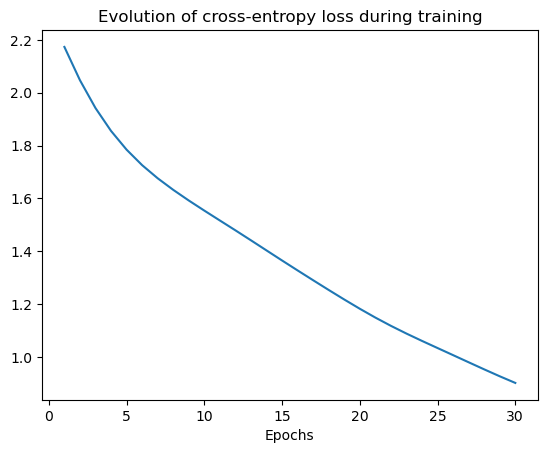

In [1551]:
N = 12
X = X_train
y = y_train
shapelet_sizes={10:24, 20: 16, 30: 8}
# shapelet_sizes={15: 24, 20: 16}
uniform_shp_clf, uniform_svm = create_shp_svm_clf(N,
                                                  X,
                                                  y,
                                                  shapelet_sizes=shapelet_sizes,
                                                  random_state=42,
                                                  uniform=True,
                                                  lr=0.02,
                                                  weight_regularizer=0.001,
                                                  max_iter=30)
# The loss history is accessible via the `model_` that is a keras model
plt.figure()
plt.plot(numpy.arange(1, uniform_shp_clf.n_iter_ + 1), uniform_shp_clf.history_["loss"])
plt.title("Evolution of cross-entropy loss during training")
plt.xlabel("Epochs")
plt.show()

1/1 [==============================] - 0s 29ms/step


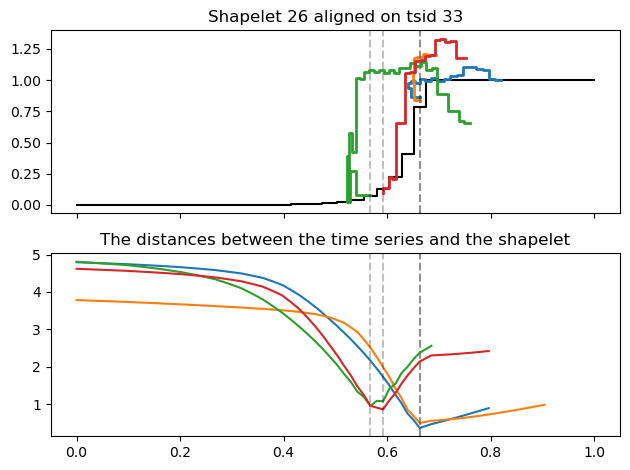

In [1552]:
min_dist_list = [min(i) for i in uniform_shp_clf.transform(X)]
minID = np.argmin(min_dist_list)

plot_shapelet(ts_id_to_plot=[minID],
              num_ts_to_plot=0,
              shp_clf=uniform_shp_clf,
              ts_data=X,
              plot_n_best_shaps=4)

1/1 [==============================] - 0s 311ms/step


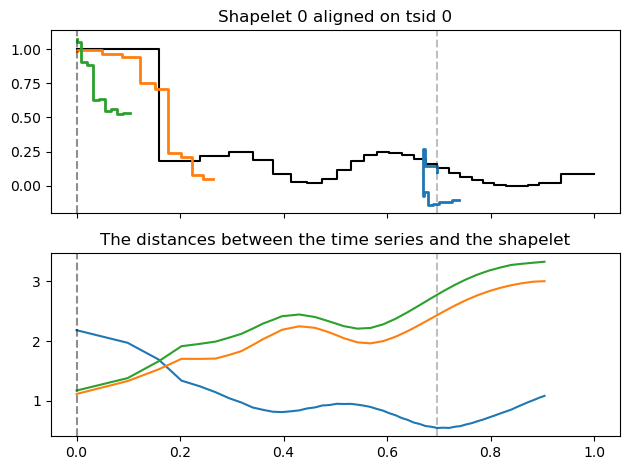

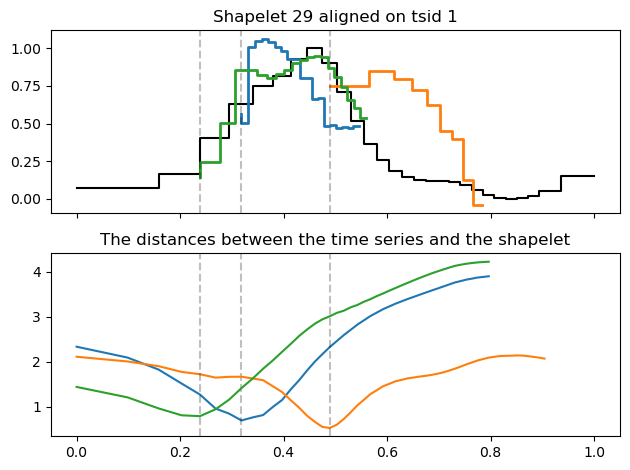

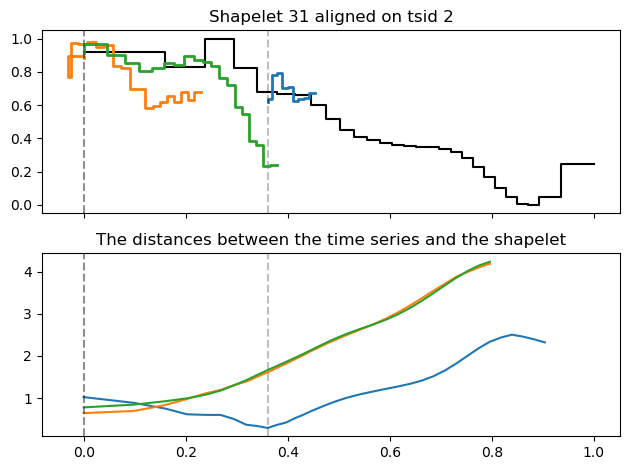

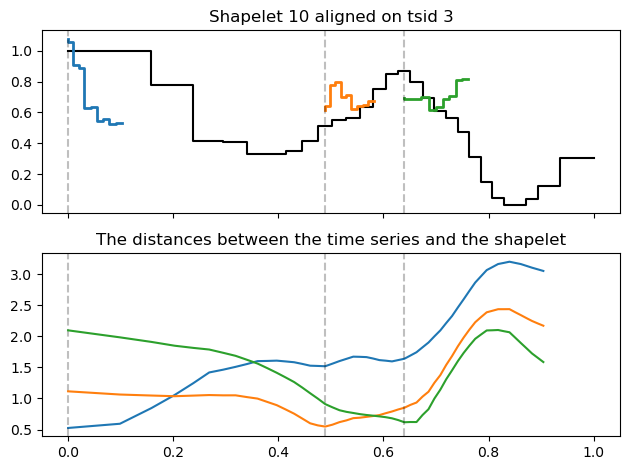

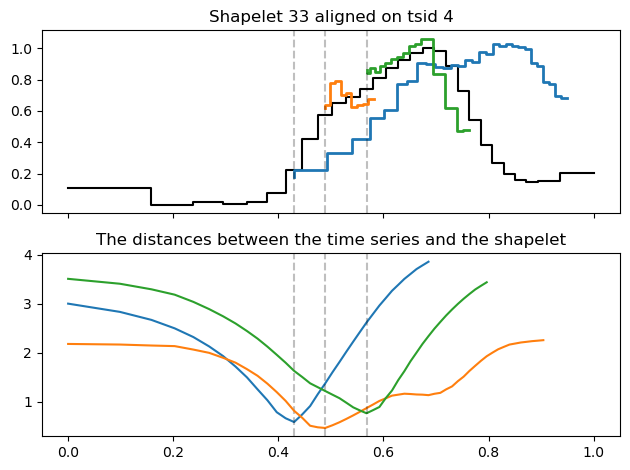

...

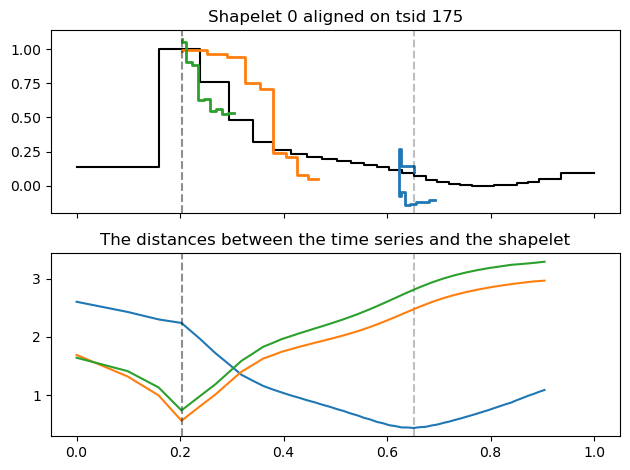

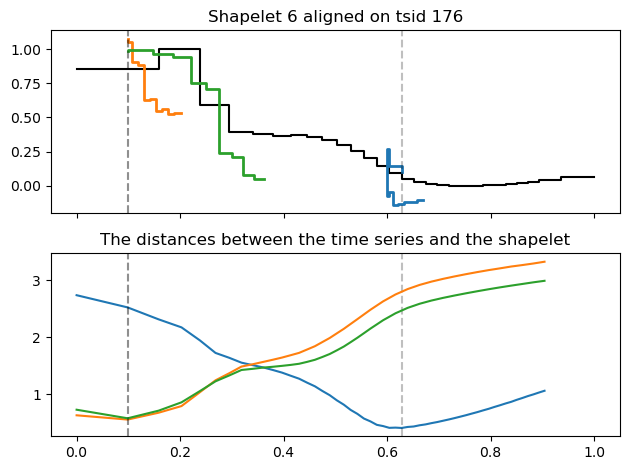

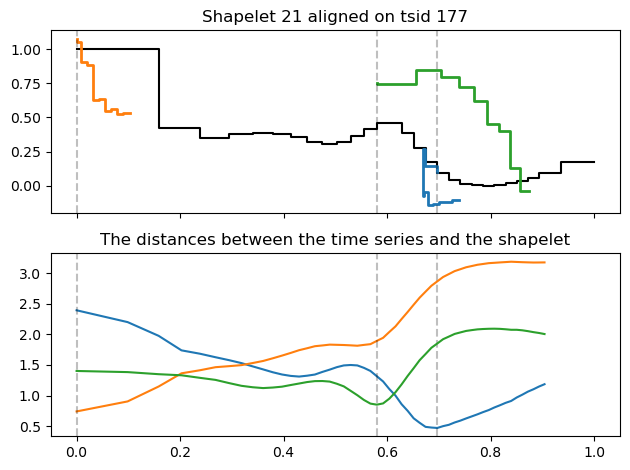

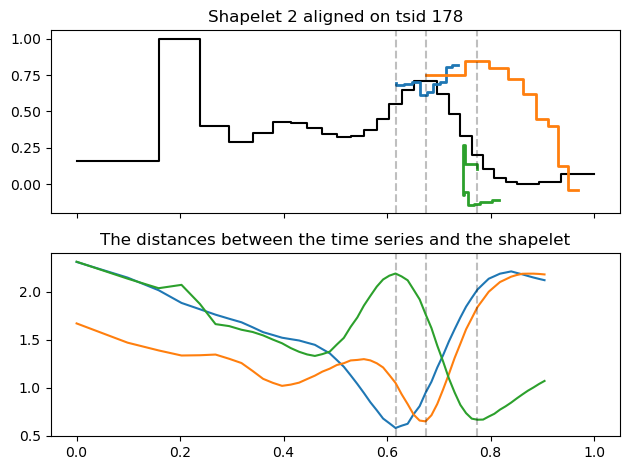

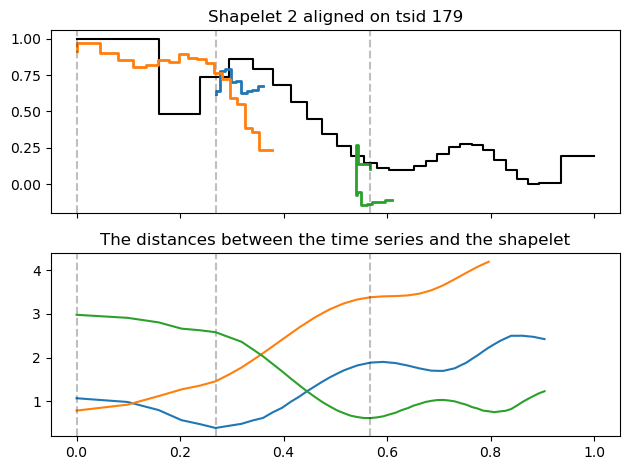

In [1568]:
# Might want to only consider non overlapping shapelets
plot_shapelet(num_ts_to_plot=180,
              shp_clf=uniform_shp_clf,
              ts_data=X,
              plot_n_best_shaps=3)

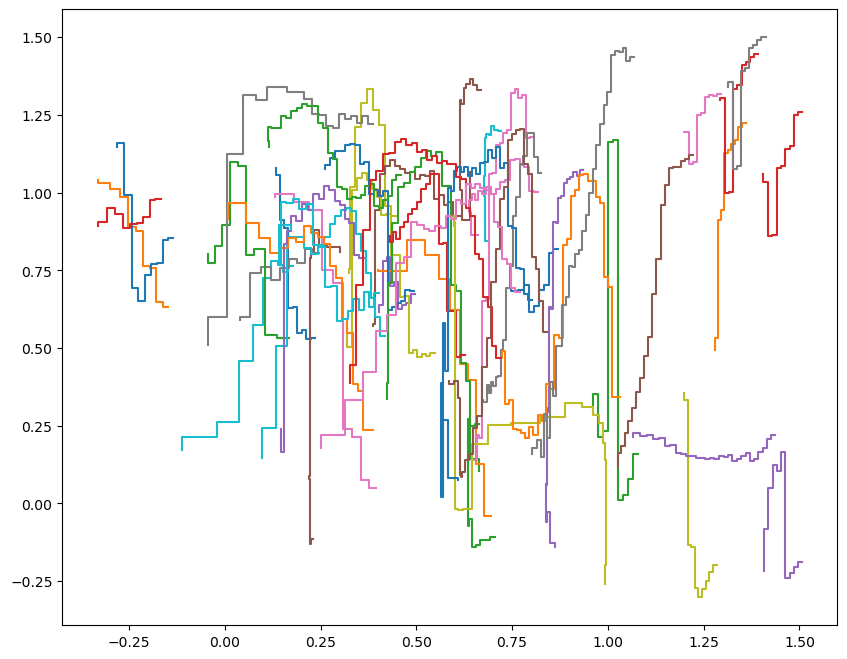

In [1556]:
plt.figure(figsize=(10,8))
for i in uniform_shp_clf.shapelets_:
    x, y = zip(*i)
#     if len(x)==30:
#         plt.step(x, y)
    plt.step(x, y)

1/1 [==============================] - 0s 68ms/step


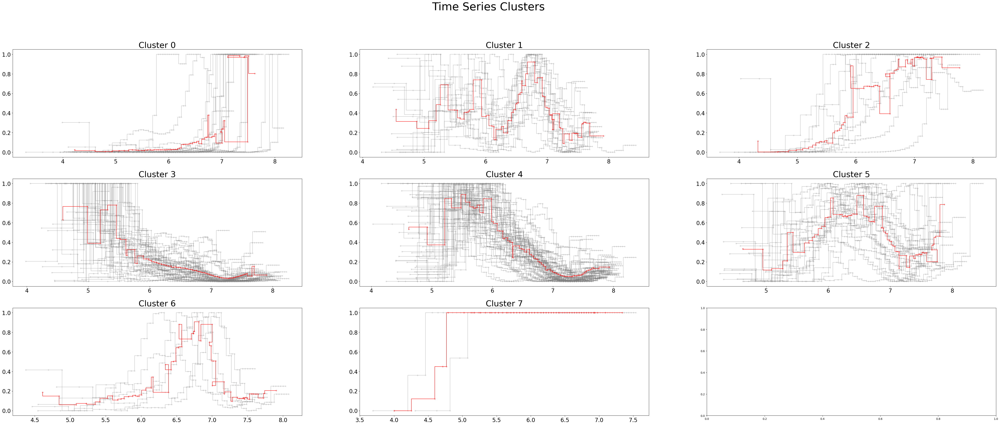

In [1569]:
svm_model = uniform_svm

X_train_shapelet_ALL = uniform_shp_clf.transform(X_train)
y_pred = svm_model.predict(X_train_shapelet_ALL)
shapelet_key_label_dict = dict()
for idx, latin_key in enumerate(latin_name_keys):
    y_pred_i = y_pred[idx]
    shapelet_key_label_dict[latin_key] = y_pred_i

plot_cluster_table(cluster_table=False,
                   Msmc_clustering_obj=False,
                   cluster_label_dict=shapelet_key_label_dict,
                   cluster_ts_dict=translated_ts_dict_latin_keyed,
                   clusts = 8,
                   x_aspect = 64,
                   y_aspect = 8,
                   cols = 3,
                   plot_barycenters = True,
                   max_iter=5)

/home/nick/miniconda3/envs/stats/lib/python3.9/site-packages/keras/optimizers/optimizer_v2/adam.py:110: UserWarning:

The `lr` argument is deprecated, use `learning_rate` instead.

/home/nick/miniconda3/envs/stats/lib/python3.9/site-packages/tslearn/shapelets/shapelets.py:354: FutureWarning:

The default value for 'scale' is set to False in version 0.4 to ensure backward compatibility, but is likely to change in a future version.



Epoch 1/30
1/1 [==============================] - 3s 3s/step - loss: 2.1697 - categorical_accuracy: 0.1591 - categorical_crossentropy: 2.1562
Epoch 2/30
1/1 [==============================] - 0s 10ms/step - loss: 2.0646 - categorical_accuracy: 0.2500 - categorical_crossentropy: 2.0513
Epoch 3/30
1/1 [==============================] - 0s 8ms/step - loss: 1.9778 - categorical_accuracy: 0.2727 - categorical_crossentropy: 1.9645
Epoch 4/30
1/1 [==============================] - 0s 9ms/step - loss: 1.9058 - categorical_accuracy: 0.3182 - categorical_crossentropy: 1.8921
Epoch 5/30
1/1 [==============================] - 0s 9ms/step - loss: 1.8435 - categorical_accuracy: 0.2500 - categorical_crossentropy: 1.8292
Epoch 6/30
1/1 [==============================] - 0s 10ms/step - loss: 1.7888 - categorical_accuracy: 0.2727 - categorical_crossentropy: 1.7735
Epoch 7/30
1/1 [==============================] - 0s 10ms/step - loss: 1.7394 - categorical_accuracy: 0.2955 - categorical_crossentropy: 1.72

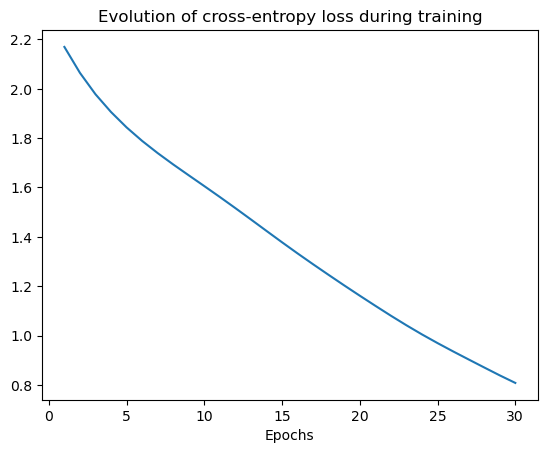

1/1 [==============================] - 0s 30ms/step


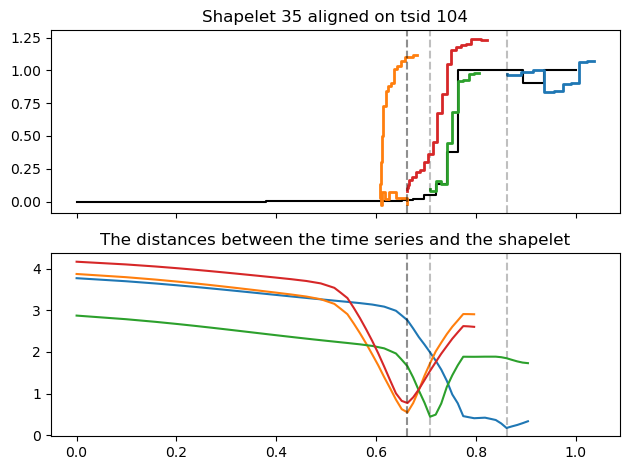

In [1573]:
N = 6
X = X_train
y = y_train
shapelet_sizes={10:24, 20: 16, 30: 8}
# shapelet_sizes={15: 24, 20: 16}
uniform_shp_clf2, uniform_svm2 = create_shp_svm_clf(N,
                                                  X,
                                                  y,
                                                  shapelet_sizes=shapelet_sizes,
                                                  random_state=42,
                                                  uniform=True,
                                                  lr=0.02,
                                                  weight_regularizer=0.001,
                                                  max_iter=30)
# The loss history is accessible via the `model_` that is a keras model
plt.figure()
plt.plot(numpy.arange(1, uniform_shp_clf2.n_iter_ + 1), uniform_shp_clf2.history_["loss"])
plt.title("Evolution of cross-entropy loss during training")
plt.xlabel("Epochs")
plt.show()

min_dist_list2 = [min(i) for i in uniform_shp_clf2.transform(X)]
minID2 = np.argmin(min_dist_list2)

plot_shapelet(ts_id_to_plot=[minID2],
              num_ts_to_plot=0,
              shp_clf=uniform_shp_clf2,
              ts_data=X,
              plot_n_best_shaps=4)

1/1 [==============================] - 0s 54ms/step


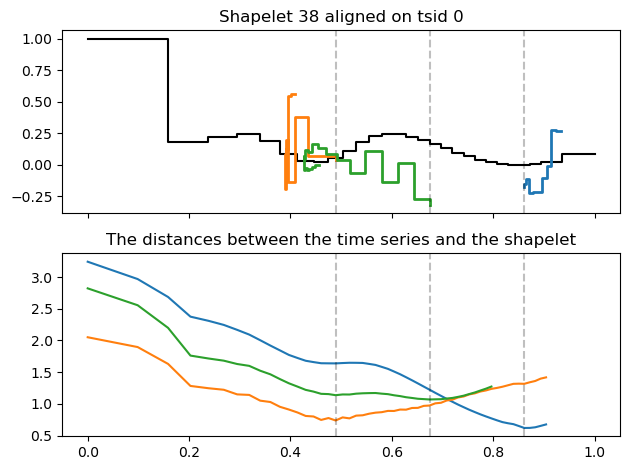

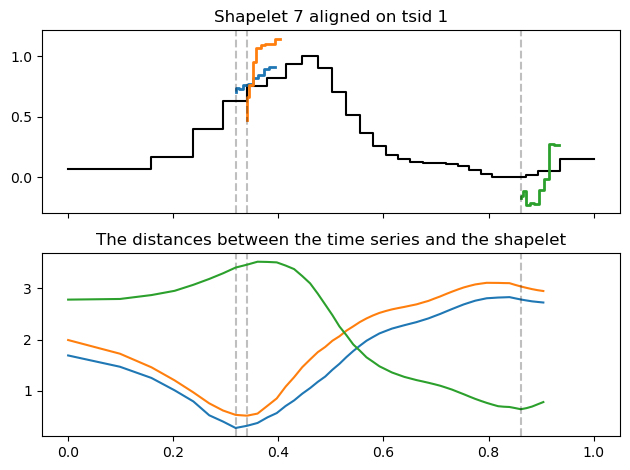

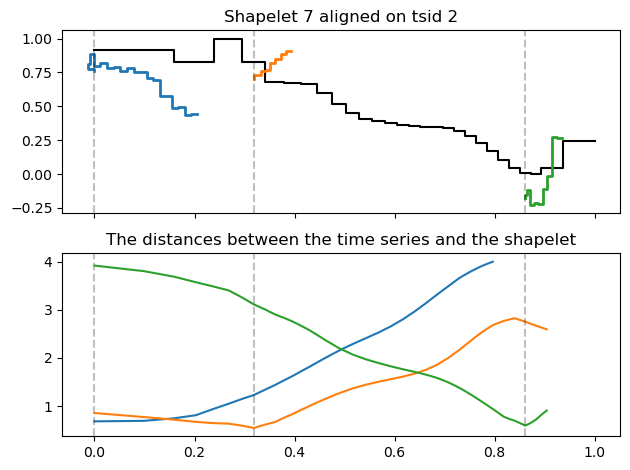

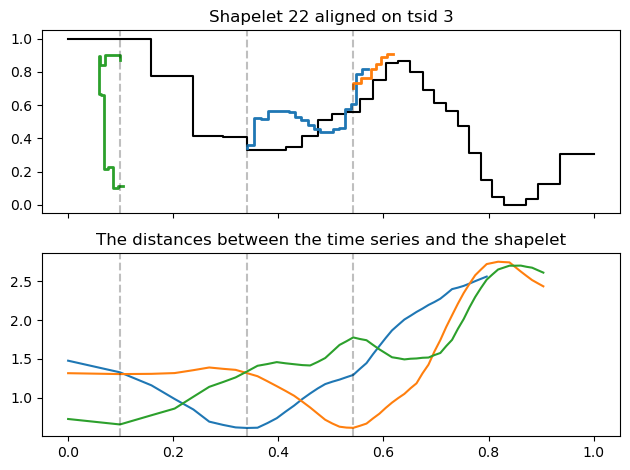

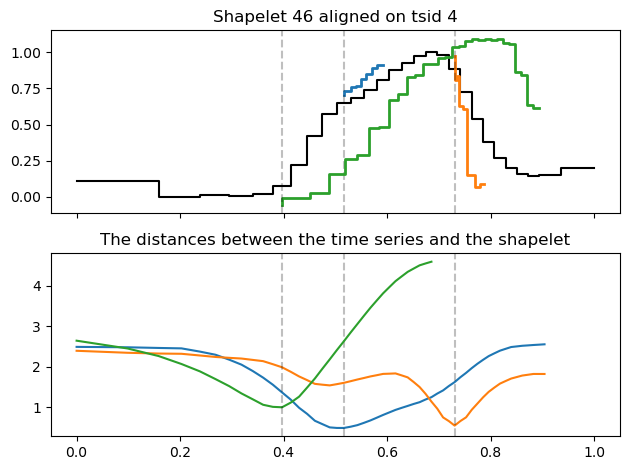

...

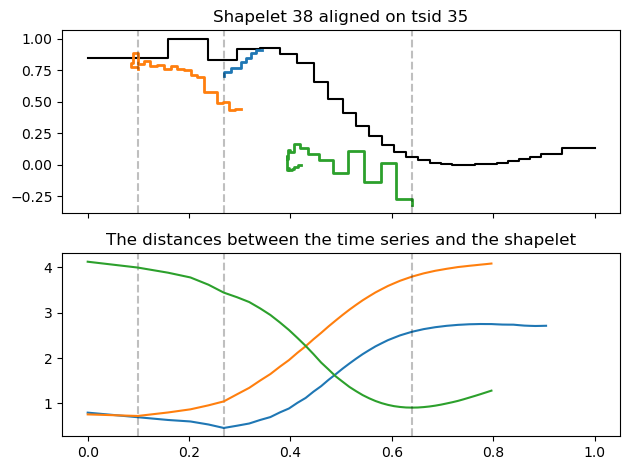

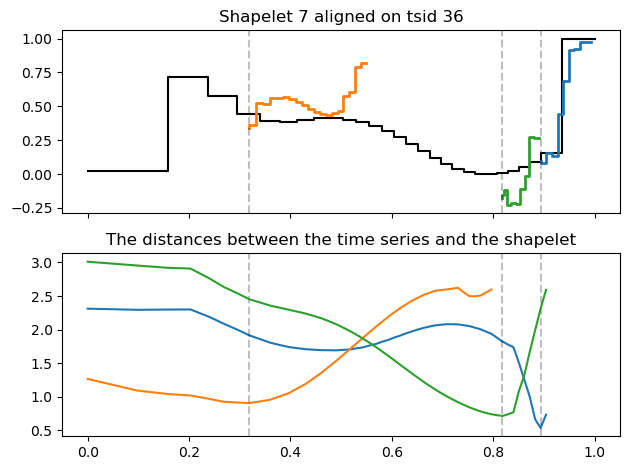

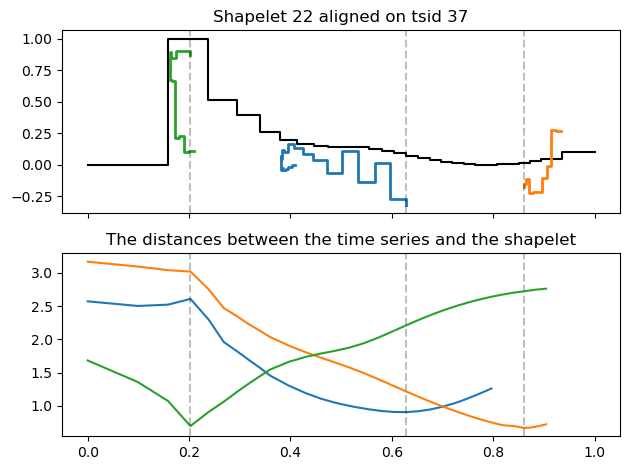

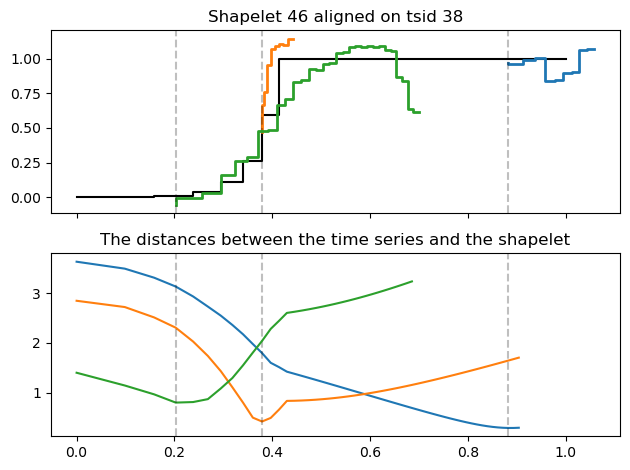

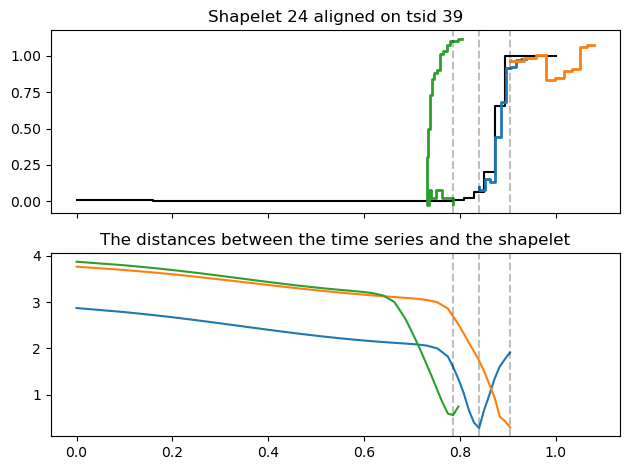

In [1574]:
# Might want to only consider non overlapping shapelets
plot_shapelet(num_ts_to_plot=40,
              shp_clf=uniform_shp_clf2,
              ts_data=X,
              plot_n_best_shaps=3)

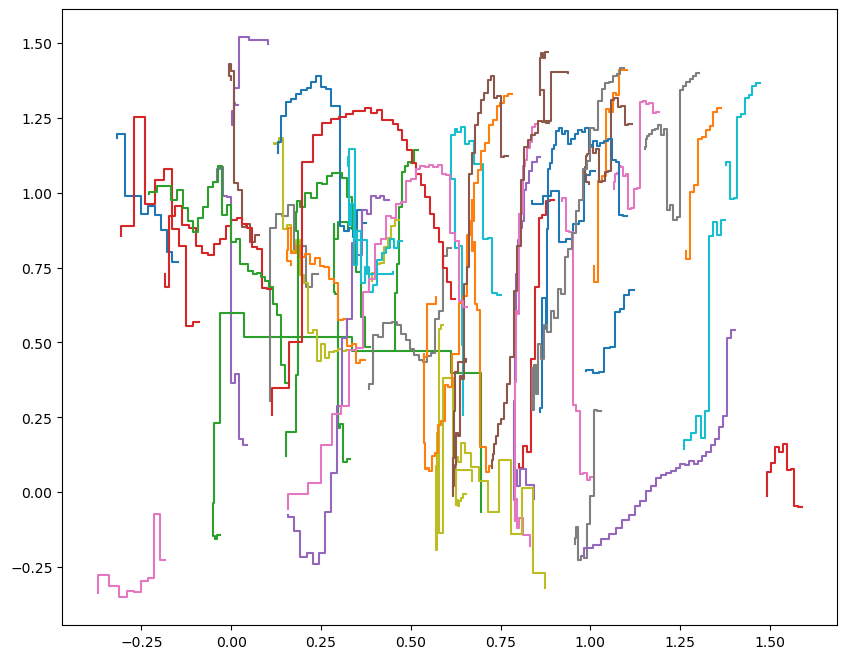

In [1575]:
plt.figure(figsize=(10,8))
for i in uniform_shp_clf2.shapelets_:
    x, y = zip(*i)
#     if len(x)==30:
#         plt.step(x, y)
    plt.step(x, y)

# PYTS Shapelet Lib

/home/nick/miniconda3/envs/stats/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/nick/miniconda3/envs/stats/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/nick/miniconda3/envs/stats/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



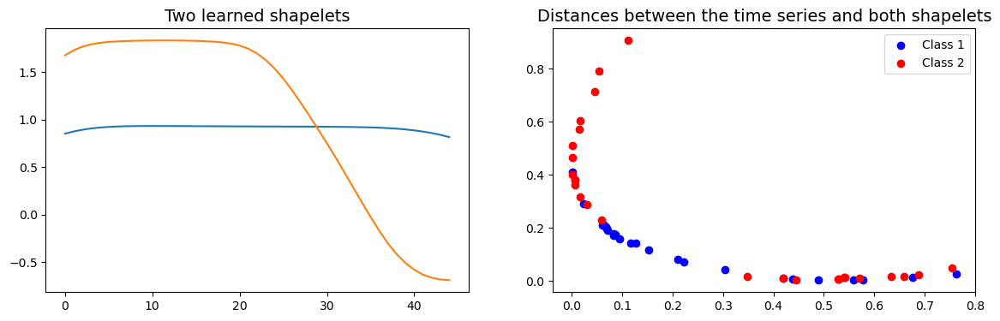

In [1318]:
import matplotlib.pyplot as plt
import numpy as np
from pyts.classification import LearningShapelets
from pyts.datasets import load_gunpoint
from pyts.utils import windowed_view

# Load the data set and fit the classifier
X, _, y, _ = load_gunpoint(return_X_y=True)
clf = LearningShapelets(random_state=42, tol=0.01)
clf.fit(X, y)

# Select two shapelets
shapelets = np.asarray([clf.shapelets_[0, -9], clf.shapelets_[0, -12]])

# Derive the distances between the time series and the shapelets
shapelet_size = shapelets.shape[1]
X_window = windowed_view(X, window_size=shapelet_size, window_step=1)
X_dist = np.mean(
    (X_window[:, :, None] - shapelets[None, :]) ** 2, axis=3).min(axis=1)

plt.figure(figsize=(14, 4))

# Plot the two shapelets
plt.subplot(1, 2, 1)
plt.plot(shapelets[0])
plt.plot(shapelets[1])
plt.title('Two learned shapelets', fontsize=14)

# Plot the distances
plt.subplot(1, 2, 2)
for color, label in zip('br', (1, 2)):
    plt.scatter(X_dist[y == label, 0], X_dist[y == label, 1],
                c=color, label='Class {}'.format(label))
plt.title('Distances between the time series and both shapelets',
          fontsize=14)
plt.legend()
plt.show()

In [1327]:
clf.shapelets_

array([[array([0.82813996, 0.83529315, 0.84073044, 0.84426206, 0.84637689,
               0.84764073, 0.84796511, 0.84769389, 0.84673086, 0.84496255,
               0.84243693, 0.83892185, 0.83391592, 0.82822376, 0.82042958]),
        array([-0.60409413, -0.6057848 , -0.60646441, -0.60653353, -0.60620838,
               -0.60567168, -0.60520122, -0.60467566, -0.60395493, -0.60298991,
               -0.60138046, -0.60127163, -0.59401041, -0.58766112, -0.57503217]),
        array([1.53324596, 1.58326376, 1.62587847, 1.65869869, 1.68130807,
               1.69391825, 1.70010738, 1.70295558, 1.70379754, 1.70327074,
               1.70078195, 1.69544654, 1.68689075, 1.67396696, 1.65573389]),
        array([-0.91296584, -0.91905541, -0.92217027, -0.92265588, -0.92088696,
               -0.91723426, -0.91280017, -0.90835368, -0.9041279 , -0.90072446,
               -0.89807959, -0.89603069, -0.89330899, -0.88902413, -0.88279162]),
        array([ 0.93525522,  0.82949327,  0.71727163,  0.59736

/home/nick/miniconda3/envs/stats/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/nick/miniconda3/envs/stats/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/nick/miniconda3/envs/stats/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



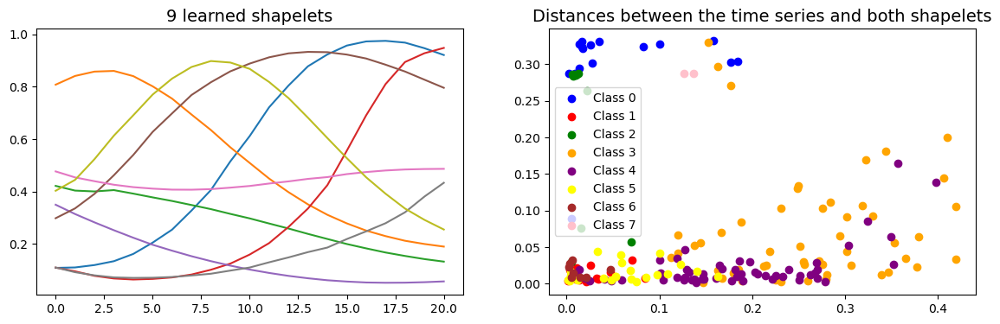

In [923]:
'''
Maybe plot out heat map (183, |shapelets|) to kinda see the X_dist stuff
'''
from pyts.classification import LearningShapelets

# Shapelets for normalized curves
latin_name_keys = list(key_label_dict.keys())
x_timeseries = np.array([translated_ts_dict_latin_keyed[i] 
                         for i in latin_name_keys])
x_timestamps = np.array([translated_ts_dict_latin_keyed[i]["left_time_boundary"] 
                         for i in latin_name_keys])
x_ne = np.array([translated_ts_dict_latin_keyed[i]["lambda"] 
                 for i in latin_name_keys])

x_unnormalized_timeseries = np.array([unnormalized_translated_ts_dict_latin_keyed[i]
                                      for i in latin_name_keys])

x_unnormalized_ne = np.array([unnormalized_translated_ts_dict_latin_keyed[i]["lambda"] 
                 for i in latin_name_keys])
y_labels = np.array([key_label_dict[i] for i in latin_name_keys])

clf = LearningShapelets(random_state=42, tol=0.01)
clf.fit(x_ne, y_labels)

# shapelets = np.array([clf.shapelets_[0, i] for i in range(1,9)]) # Gotta pick shapelets of the same size
shapelets = np.array([clf.shapelets_[0, i] for i in range(30, 39)]) # Gotta pick shapelets of the same size

# Derive the distances between the time series and the shapelets
# shapelet_size = shapelets.shape[1]
shapelet_size = shapelets.shape[1]
X_window = windowed_view(x_ne, window_size=shapelet_size, window_step=1)

# X_dist shows the distances between each time series and the shapelets
# I think each of the entries in each row are the minimum shapelet dist (out of all shapelets)
X_dist = np.mean(
    (X_window[:, :, None] - shapelets[None, :]) ** 2, axis=3).min(axis=1)
X_dist_raw = np.mean(
    (X_window[:, :, None] - shapelets[None, :]) ** 2, axis=3)
# Order has nothing to do with labels as far as I know
colors = ['blue', 'red', 'green', 'orange', 'purple', 'yellow', 'brown', 'pink']
plt.figure(figsize=(14, 4))

plt.subplot(1, 2, 1)
# Color not really associated with shapelet
for idx, i in enumerate(shapelets):
    plt.plot(shapelets[idx])
plt.title(f'{len(shapelets)} learned shapelets', fontsize=14)

# Plot the distances
plt.subplot(1, 2, 2)
for color, label in zip(colors, list(range(len(shapelets)))):
    plt.scatter(X_dist[y_labels == label, 0], X_dist[y_labels == label, 1],
                c=color, label='Class {}'.format(label))
    plt.xlabel("")
plt.title('Distances between the time series and both shapelets',
          fontsize=14)
plt.legend()
plt.show()

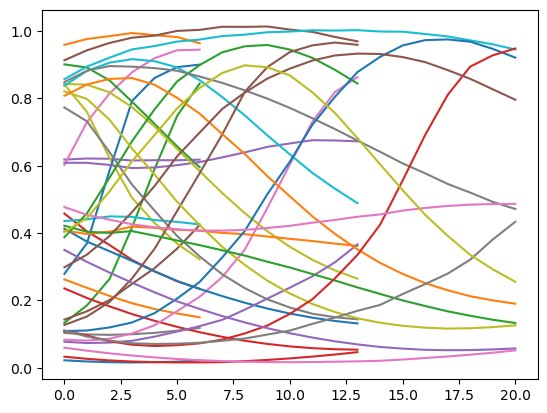

In [924]:
for shapl in clf.shapelets_[0]:
    plt.plot(shapl)

In [925]:
from pyts.transformation import ShapeletTransform
shapelet_transform = ShapeletTransform(window_sizes=np.array([21]), random_state=42)
svc = LinearSVC()
clf = make_pipeline(shapelet_transform, svc)
clf.fit(x_ne, y_labels)
clf.score(x_ne, y_labels)

clf.predict(x_ne)


KeyboardInterrupt



In [513]:
clf.score(x_ne, y_labels)

0.4644808743169399

In [ ]:
shapelet_transform

array([array([0.02225042, 0.018723  , 0.01662552, 0.01574388, 0.01658211,
              0.0181631 , 0.02172168])                                   ,
       array([0.95876212, 0.97594479, 0.98471888, 0.99372623, 0.9876371 ,
              0.98181627, 0.96351245])                                   ,
       array([0.13349516, 0.18506936, 0.26336502, 0.41664719, 0.59021026,
              0.74769561, 0.84385626])                                   ,
       array([0.45781633, 0.40496036, 0.36470622, 0.32020362, 0.28615094,
              0.25684893, 0.23443384])                                   ,
       array([0.61805525, 0.62131602, 0.62061225, 0.61530763, 0.61628214,
              0.61611674, 0.61790643])                                   ,
       array([0.14304712, 0.16770792, 0.20101669, 0.24915799, 0.29581534,
              0.35379056, 0.42374783])                                   ,
       array([0.60230067, 0.72935698, 0.81424571, 0.87737308, 0.91925952,
              0.94260975, 0.9444

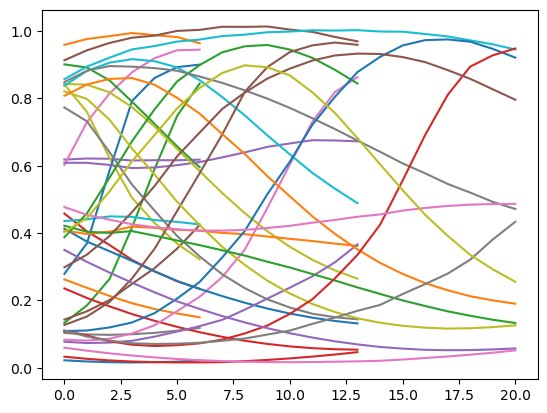

In [495]:


for shapelet in clf.shapelets_[0]:
    plt.plot(shapelet)

clf.shapelets_[0]

In [496]:

X_dist.shape

(183, 8)

In [497]:
X_dist_raw.shape

(183, 57, 8)

(183, 8)

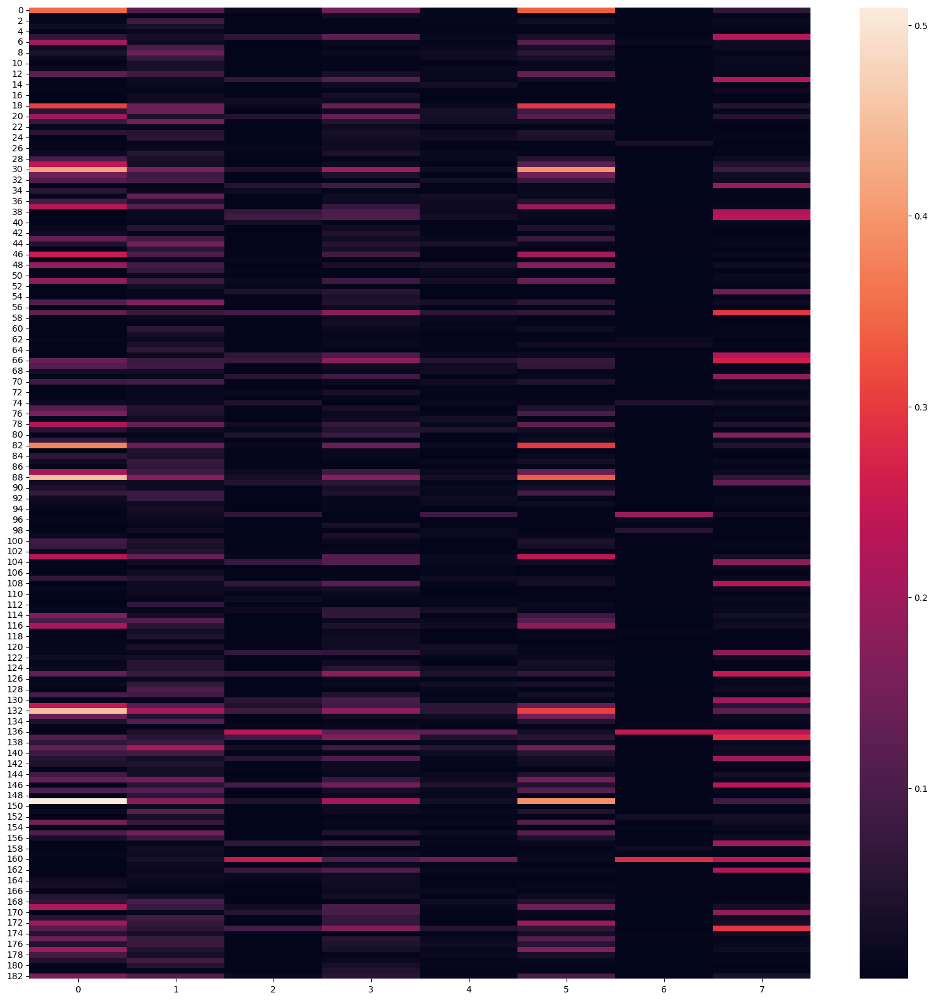

In [472]:
plt.figure(figsize=(20,20))
sns.heatmap(X_dist)
X_dist.shape

In [469]:
latin_name_keys

['Aegithalos_caudatus',
 'Aegotheles_bennettii',
 'Alca_torda',
 'Aleadryas_rufinucha',
 'Amazona_guildingii',
 'Anhinga_anhinga',
 'Anhinga_rufa',
 'Anseranas_semipalmata',
 'Aramus_guarauna',
 'Arenaria_interpres',
 'Atrichornis_clamosus',
 'Baryphthengus_martii',
 'Bombycilla_garrulus',
 'Brachypteracias_leptosomus',
 'Bucco_capensis',
 'Bucorvus_abyssinicus',
 'Buphagus_erythrorhynchus',
 'Burhinus_bistriatus',
 'Calcarius_ornatus',
 'Callaeas_cinereus',
 'Caloenas_nicobarica',
 'Calyptomena_viridis',
 'Campylorhamphus_procurvoides',
 'Cardinalis_cardinalis',
 'Catharus_fuscescens',
 'Centropus_bengalensis',
 'Centropus_unirufus',
 'Cephalopterus_ornatus',
 'Cepphus_grylle',
 'Cettia_vulcania',
 'Ceuthmochares_aereus',
 'Chaetops_frenatus',
 'Chauna_torquata',
 'Chionis_minor',
 'Chloroceryle_aenea',
 'Chloropsis_cyanopogon',
 'Chloropsis_hardwickii',
 'Chunga_burmeisteri',
 'Ciconia_maguari',
 'Cinclus_mexicanus',
 'Cisticola_juncidis',
 'Climacteris_rufus',
 'Cnemophilus_loriae',

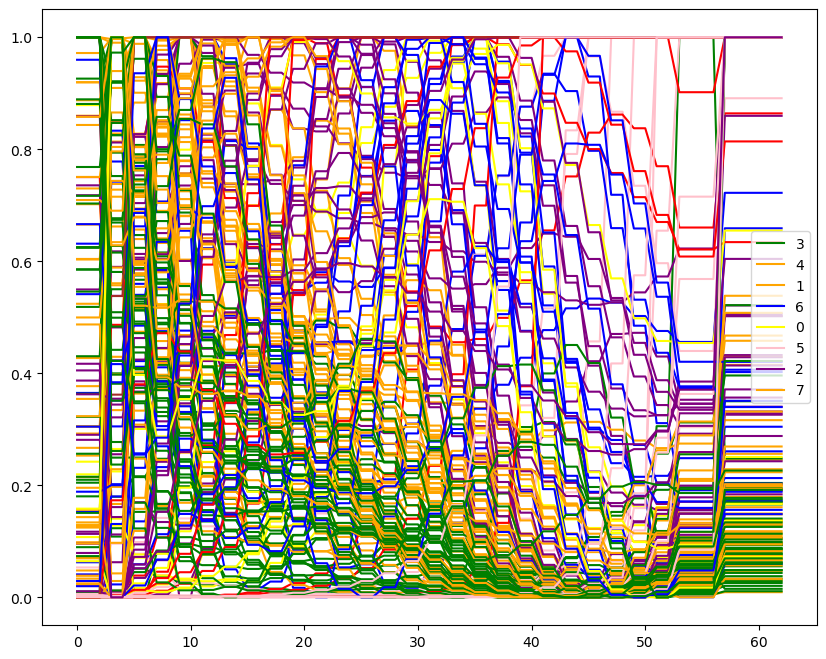

In [1481]:
plt.figure(figsize=(10,8))
shapelet_lens = [len(i) for i in clf.shapelets_[0]]
colors = ['blue', 'red', 'green', 'orange', 'purple', 'yellow', 'brown', 'pink']
label2color=dict()
for idx, x_i in enumerate(x_ne):
    y_i = y_labels[idx]
    c = colors[y_i-1]
    plt.plot(x_i, c=c)
    label2color[y_i] = c
plt.legend(label2color)

In [418]:
'''
     21     (X_window[:, :, None] - shapelets[None, :]) ** 2, axis=3).min(axis=1)
     
2 shapelets
X_window[:, :, None].shape : (183, 43, 1, 21)
shapelets[None, :].shape   : (1, 2, 21)

8 shapelets
X_window[:, :, None].shape : (183, 43, 1, 21)
shapelets[None, :].shape   : (1, 8)
'''
print(X_window[:, :, None].shape)
print(shapelets[None, :].shape)

(183, 56, 1, 8)
(1, 8)


/home/nick/miniconda3/envs/stats/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/nick/miniconda3/envs/stats/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/nick/miniconda3/envs/stats/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



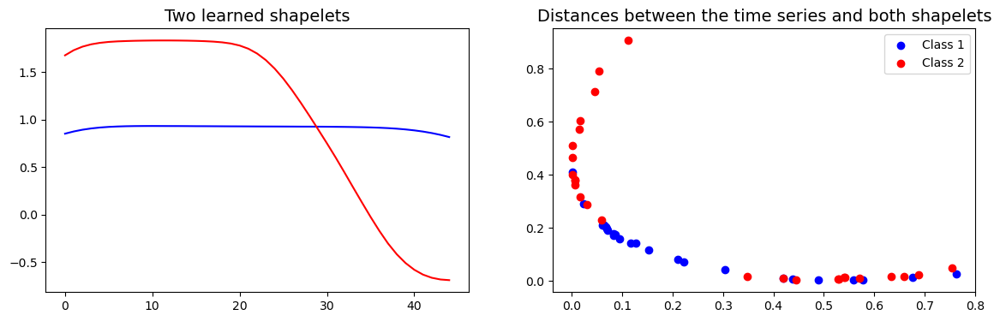

In [441]:
# Load the data set and fit the classifier
X, _, y, _ = load_gunpoint(return_X_y=True)
clf = LearningShapelets(random_state=42, tol=0.01)
clf.fit(X, y)

# Select two shapelets
shapelets = np.asarray([clf.shapelets_[0, -9], clf.shapelets_[0, -12]])

# Derive the distances between the time series and the shapelets
shapelet_size = shapelets.shape[1]
X_window = windowed_view(X, window_size=shapelet_size, window_step=1)
X_dist = np.mean(
    (X_window[:, :, None] - shapelets[None, :]) ** 2, axis=3).min(axis=1)

plt.figure(figsize=(14, 4))

# Plot the two shapelets
plt.subplot(1, 2, 1)
plt.plot(shapelets[0], c="b")
plt.plot(shapelets[1], c="r")
plt.title('Two learned shapelets', fontsize=14)

# Plot the distances
plt.subplot(1, 2, 2)
for color, label in zip('br', (1, 2)):
    plt.scatter(X_dist[y == label, 0], X_dist[y == label, 1],
                c=color, label='Class {}'.format(label))
plt.title('Distances between the time series and both shapelets',
          fontsize=14)
plt.legend()
plt.show()

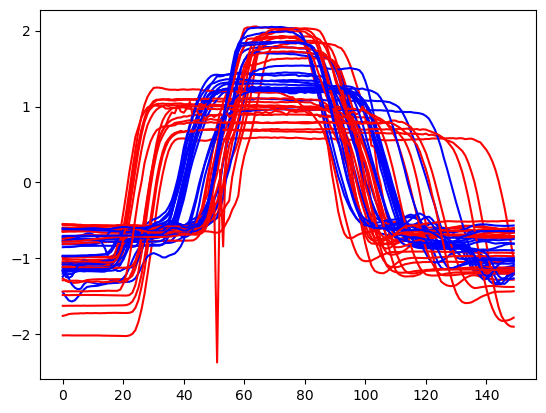

In [296]:
colors = ["b", "r"]
for idx, x_i in enumerate(X):
    y_i = y[idx]
    c = colors[y_i-1]
    plt.plot(x_i, c=c)

# Taking a peak at what the metadata dataframe looks like when joined with cluster label df on "Latin name" indices

[CAN CHOOSE CLUSTER LABEL SCHEMA IN THIS CODE CELL]

# ANOVA using statsmodels api


In [1383]:
import statsmodels.api as sm
from statsmodels.formula.api import ols
pd.set_option("display.max_columns", None)

def anova_on_df(df, avonet_df, traits, formula):
    '''
    Joins your clustering table df (latin name, sample name, labels) with 
    an avonet dataframe which a 1-way ANOVA can be performed on. 
    
    Independent Variable: Everything
    Dependent Variable  : Label
    '''
    df_avonet3.loc[df.index] # Make selection on avonet using df indices
    df_joined = avonet_df.join(df, on=avonet_df.index).dropna(subset=["Labels"]) # Join avonet3 df with chosen df (default df) on "Latin name"
    # Load your data into a pandas dataframe
    df = df_joined.copy()
    df.columns = [i.replace('.','_').replace("-", "_") for i in df.columns]
    # Use statsmodel ols function to fit model using ordinary least squares
    model = ols(formula, df).fit()
    # Perform ANOVA
    aov_table = sm.stats.anova_lm(model, typ=2)
    return (model, aov_table, df)

# Performs translations on all clusters, like one done on new_944
def translate_df_for_avonet(ARI_tested_cluster_table_dict,
                            df_avonet3):
    '''
    Takes in dict keyed by clustering seed. Each val is a cluster table for the
    seed. Translates the cluster table's indices to match the species available
    in avonet3. Outputs a cluster table of the same type as the one taken as
    input, but possibly with different indices (Species Latin names).
    '''
    translated_ARI_cluster_tables = dict()
    for key in ARI_tested_cluster_table_dict.keys():
        translated_ARI_cluster_tables[key] = grab_and_translate_cluster_labels(df=ARI_tested_cluster_table_dict[key],
                                                                               df_avonet3=df_avonet3,
                                                                               translate2avonet3 = "MSMC-Exploratory-Analysis/results/consistency-tests/ARI_testing/",
                                                                               verbose=False,
                                                                               verboser=False)
    return translated_ARI_cluster_tables

def perform_anovas(translated_ARI_cluster_tables,
                   df_avonet3,
                   traits,
                   formula):
    '''
    Using a dict of cluster tables, performs an ANOVA for each cluster table
    (df). Outputs a dict keyed by the seeds used to make each cluster table
    with their corresponding values being results of an ANOVA.
    
    Notes on output:
    Get a dict keyed by random seeds to hold ANOVA results
    Each item in ARI_tested_cluster_ANOVA_dict is a tuple with:
    [0] - model
    [1] - ANOVA results
    [2] - AVONET & cluster labels Joined Table
    '''
    ARI_tested_cluster_ANOVA_dict = dict()
    for key in translated_ARI_cluster_tables.keys():
        df = translated_ARI_cluster_tables[key]
        ARI_tested_cluster_ANOVA_dict[key] = anova_on_df(df=df,
                                                         avonet_df=df_avonet3,
                                                         traits=traits,
                                                         formula=formula)
    return ARI_tested_cluster_ANOVA_dict

def boxplots_for_mass_anova(ARI_tested_cluster_ANOVA_dict):
    '''
    Takes in dicts produced by perform_anovas().
    
    Create boxplots for each feature to see distributions of F and PR(>F)
    Make a df for each feature and compile all F and PR(>F) values into 2 columns.
    Then each feature will have its own 2 boxplots
    '''
    features = list(list(ARI_tested_cluster_ANOVA_dict.values())[0][1].index)[:-1]
    result = []
    for key in ARI_tested_cluster_ANOVA_dict.keys():
        result.append(ARI_tested_cluster_ANOVA_dict[key][1])   

    main_df = pd.concat(result)
    fig, ax = plt.subplots(2, len(features), figsize=(40, 20))

    field="F"
    # ax.set_title(f"Distribution of {field}")
    for idx, feature in enumerate(features):
        df = main_df.loc[feature]
        sns.boxplot(y=df[field], ax=ax[0, idx])
        ax[0,idx].set_xlabel(feature)
        if idx==0:
            ax[0, idx].set_ylabel(field)
        else:
            ax[0, idx].set_ylabel("")
    # ax.set_title(f"Distribution of {field}")
    field="PR(>F)"
    for idx, feature in enumerate(features):
        df = main_df.loc[feature]
        sns.boxplot(y=df[field], ax=ax[1, idx])
        ax[1,idx].set_xlabel(feature)
        if idx==0:
            ax[1, idx].set_ylabel(field)
        else:
            ax[1, idx].set_ylabel("")
    

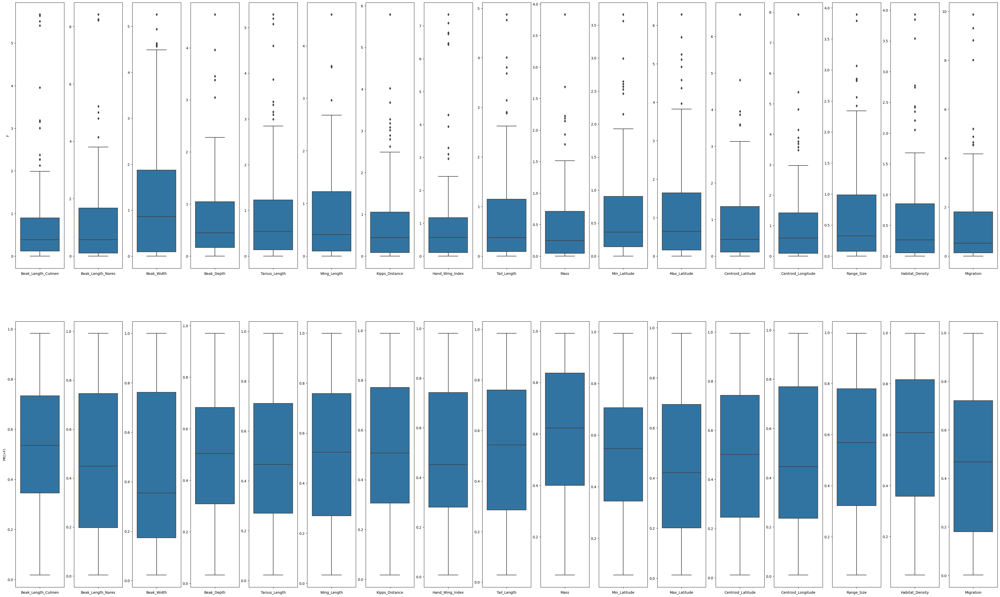

In [1380]:
translated_ARI_cluster_tables = translate_df_for_avonet(ARI_tested_cluster_table_dict, df_avonet3)

traits = "Beak.Length_Culmen + Beak.Length_Nares + Beak.Width + Beak.Depth + \
Tarsus.Length + Wing.Length + Kipps.Distance + Hand-Wing.Index + \
Tail.Length + Mass + Min.Latitude + Max.Latitude + \
Centroid.Latitude + Centroid.Longitude + Range.Size + Habitat.Density + \
Migration".replace(".", "_").replace("-", "_")
formula = f'Labels ~ {traits}'

ARI_tested_cluster_ANOVA_dict = perform_anovas(translated_ARI_cluster_tables,
                                               df_avonet3,
                                               traits,
                                               formula)


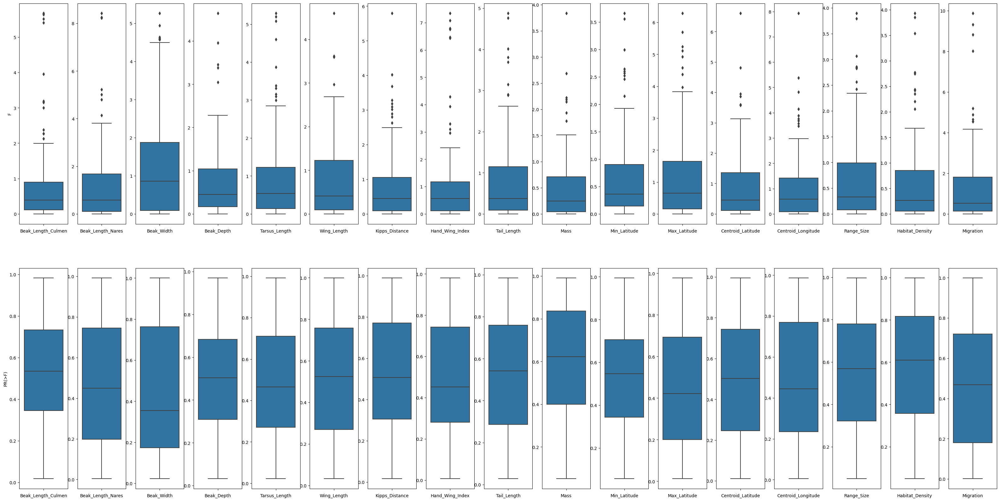

In [1384]:
boxplots_for_mass_anova(ARI_tested_cluster_ANOVA_dict)

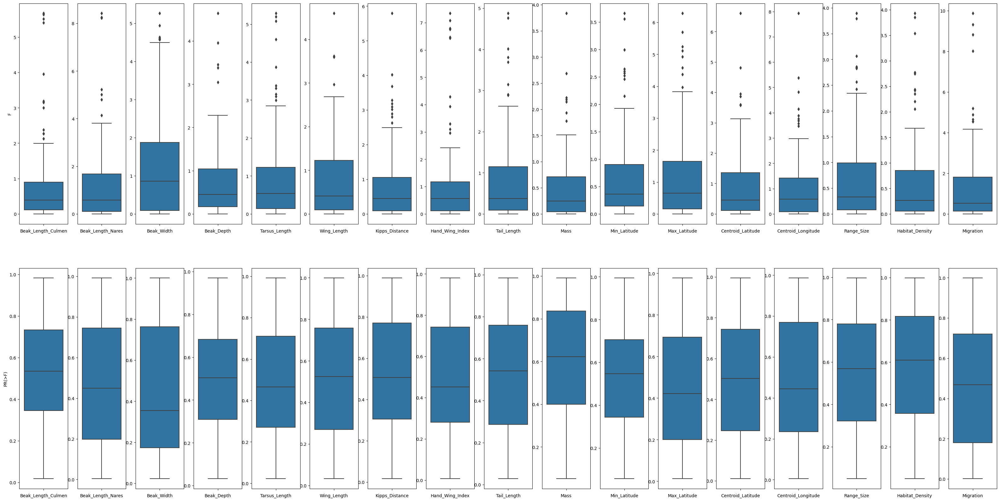

In [1385]:
features = list(list(ARI_tested_cluster_ANOVA_dict.values())[0][1].index)[:-1]
result = []
for key in ARI_tested_cluster_ANOVA_dict.keys():
    result.append(ARI_tested_cluster_ANOVA_dict[key][1])   

main_df = pd.concat(result)
fig, ax = plt.subplots(2, len(features), figsize=(40, 20))

field="F"
# ax.set_title(f"Distribution of {field}")
for idx, feature in enumerate(features):
    df = main_df.loc[feature]
    sns.boxplot(y=df[field], ax=ax[0, idx])
    ax[0,idx].set_xlabel(feature)
    if idx==0:
        ax[0, idx].set_ylabel(field)
    else:
        ax[0, idx].set_ylabel("")
# ax.set_title(f"Distribution of {field}")
field="PR(>F)"
for idx, feature in enumerate(features):
    df = main_df.loc[feature]
    sns.boxplot(y=df[field], ax=ax[1, idx])
    ax[1,idx].set_xlabel(feature)
    if idx==0:
        ax[1, idx].set_ylabel(field)
    else:
        ax[1, idx].set_ylabel("")

In [1406]:
main_df.loc["Centroid_Latitude"]

,sum_sq,df,F,PR(>F)
Centroid_Latitude,2.625802,1.0,0.475174,0.491591
Centroid_Latitude,1.111722,1.0,0.199699,0.655554
Centroid_Latitude,2.479726,1.0,0.364264,0.546981
Centroid_Latitude,11.266144,1.0,2.572174,0.110682
Centroid_Latitude,0.233181,1.0,0.050997,0.821619
...,...,...,...,...
Centroid_Latitude,0.379030,1.0,0.055778,0.813592
Centroid_Latitude,4.375721,1.0,0.698884,0.404375
Centroid_Latitude,1.260541,1.0,0.249155,0.618340
Centroid_Latitude,6.658415,1.0,1.096158,0.296651


In [1438]:
# Make df for F on all features
f_df = pd.DataFrame()
features = list(main_df.index.unique())[:-1]
for feature in features:
    f_df[feature] = main_df.loc[feature,"F"].to_numpy()
    
p_df = pd.DataFrame()
features = list(main_df.index.unique())[:-1]
for feature in features:
    p_df[feature] = main_df.loc[feature,"PR(>F)"].to_numpy()

In [1439]:
p_df

,Beak_Length_Culmen,Beak_Length_Nares,Beak_Width,Beak_Depth,Tarsus_Length,Wing_Length,Kipps_Distance,Hand_Wing_Index,Tail_Length,Mass,Min_Latitude,Max_Latitude,Centroid_Latitude,Centroid_Longitude,Range_Size,Habitat_Density,Migration
0,0.574493,0.870062,0.830023,0.210159,0.093669,0.881473,0.988079,0.824784,0.346583,0.292726,0.922066,0.333960,0.491591,0.595890,0.546449,0.665215,0.579668
1,0.651116,0.940681,0.965118,0.825627,0.460667,0.506872,0.349763,0.412741,0.192676,0.769220,0.484026,0.971656,0.655554,0.864455,0.793530,0.940758,0.768020
2,0.788945,0.795000,0.873571,0.251703,0.293636,0.382156,0.837858,0.549574,0.159255,0.280493,0.475912,0.932837,0.546981,0.934571,0.121565,0.891176,0.736062
3,0.278906,0.172586,0.736943,0.558458,0.704690,0.542103,0.976791,0.936808,0.621736,0.970701,0.557108,0.052240,0.110682,0.005469,0.842824,0.358567,0.002644
4,0.021239,0.004608,0.065515,0.384406,0.751414,0.663528,0.091033,0.007448,0.855976,0.990676,0.453777,0.971757,0.821619,0.690222,0.622548,0.690799,0.028629
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,0.653016,0.594576,0.725643,0.292845,0.474213,0.701991,0.973533,0.527095,0.444582,0.884537,0.544750,0.924202,0.813592,0.981318,0.287047,0.918296,0.084901
96,0.962794,0.977141,0.931228,0.595183,0.297308,0.434356,0.768319,0.434017,0.933293,0.458821,0.818772,0.385762,0.404375,0.670004,0.819301,0.920306,0.644641
97,0.963361,0.674202,0.139574,0.315650,0.443289,0.673225,0.270286,0.186892,0.227531,0.236442,0.559982,0.946315,0.618340,0.260734,0.404441,0.392125,0.849039
98,0.227419,0.113034,0.296197,0.377470,0.812745,0.988915,0.741291,0.320604,0.942791,0.555713,0.844719,0.204160,0.296651,0.234834,0.933484,0.127086,0.767615


Text(0, 0.5, 'P Value')

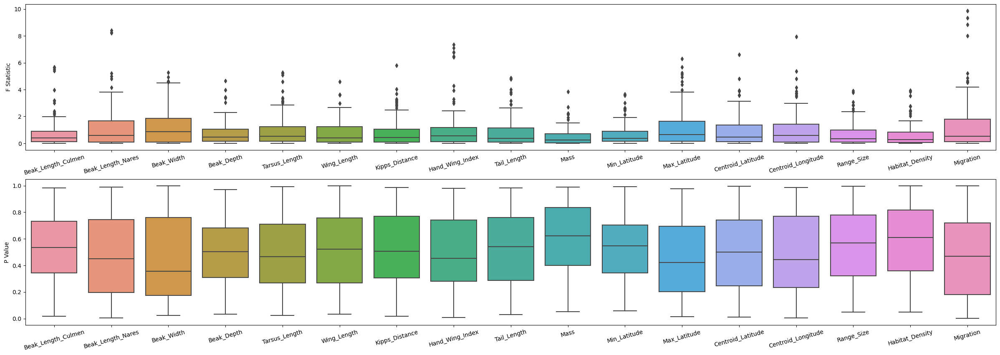

In [1447]:
fig, axs = plt.subplots(2, figsize=(30, 10))

sns.boxplot(data=f_df, ax=axs[0])
labs = list(range(len(features)))
axs[0].set_xticks(labs,features, rotation=15)
axs[0].set_ylabel("F Statistic")

sns.boxplot(data=p_df, ax=axs[1])
labs = list(range(len(features)))
axs[1].set_xticks(labs,features, rotation=15)
axs[1].set_ylabel("P Value")

([<matplotlib.axis.XTick at 0x7f0439f62c70>,
 [Text(0, 0, 'Beak_Length_Culmen'),
  Text(1, 0, 'Beak_Length_Nares'),
  Text(2, 0, 'Beak_Width'),
  Text(3, 0, 'Beak_Depth'),
  Text(4, 0, 'Tarsus_Length'),
  Text(5, 0, 'Wing_Length'),
  Text(6, 0, 'Kipps_Distance'),
  Text(7, 0, 'Hand_Wing_Index'),
  Text(8, 0, 'Tail_Length'),
  Text(9, 0, 'Mass'),
  Text(10, 0, 'Min_Latitude'),
  Text(11, 0, 'Max_Latitude'),
  Text(12, 0, 'Centroid_Latitude'),
  Text(13, 0, 'Centroid_Longitude'),
  Text(14, 0, 'Range_Size'),
  Text(15, 0, 'Habitat_Density'),
  Text(16, 0, 'Migration')])

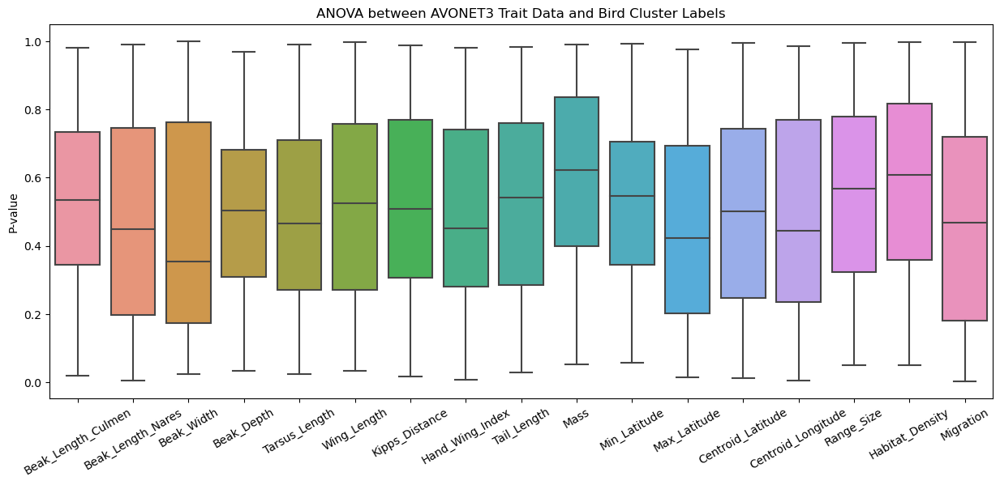

In [1454]:
plt.figure(figsize=(15,6))
plt.title("ANOVA between AVONET3 Trait Data and Bird Cluster Labels")
plt.ylabel("P-value")
sns.boxplot(data=p_df)
labs = list(range(len(features)))
plt.xticks(labs,features, rotation=30)


In [1332]:
ARI_tested_cluster_ANOVA_dict

{1390: (<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x7f042bd38040>,
                          sum_sq     df         F    PR(>F)
  Beak_Length_Culmen    1.748919    1.0  0.316490  0.574493
  Beak_Length_Nares     0.148330    1.0  0.026842  0.870062
  Beak_Width            0.255472    1.0  0.046231  0.830023
  Beak_Depth            8.746023    1.0  1.582710  0.210159
  Tarsus_Length        15.710880    1.0  2.843094  0.093669
  Wing_Length           0.123234    1.0  0.022301  0.881473
  Kipps_Distance        0.001237    1.0  0.000224  0.988079
  Hand_Wing_Index       0.271730    1.0  0.049173  0.824784
  Tail_Length           4.923888    1.0  0.891043  0.346583
  Mass                  6.156973    1.0  1.114187  0.292726
  Min_Latitude          0.053052    1.0  0.009600  0.922066
  Max_Latitude          5.188945    1.0  0.939009  0.333960
  Centroid_Latitude     2.625802    1.0  0.475174  0.491591
  Centroid_Longitude    1.560209    1.0  0.282341  0.595890
  Range_Si

In [9]:
'''
Visualize birds over world map
'''
import folium
from pygbif import species
from pygbif import occurrences as occ

key = list(ARI_tested_cluster_ANOVA_dict.keys())[0]
colors = ['red', 'blue', 'green', 'purple', 'orange', 'yellow', 'pink', 
          'gray', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'white', 
          'lightred', 'lightblue', 'lightgreen', 'beige', 'black', 'lightgray']
m = folium.Map()
ct = 0
for idx in ARI_tested_cluster_ANOVA_dict[key][2].index:
    longitude = ARI_tested_cluster_ANOVA_dict[key][2].loc[idx]["Centroid_Longitude"]
    latitude = ARI_tested_cluster_ANOVA_dict[key][2].loc[idx]["Centroid_Latitude"]
    popup = idx
    color = colors[int(ARI_tested_cluster_ANOVA_dict[key][2].loc[idx]["Labels"])]
    if np.isnan(longitude) or np.isnan(latitude):
        print(f"{idx} used gbif")
        splist = [idx.replace("_", " ")]
        keyss = [species.name_backbone(x)['usageKey'] for x in splist ]
        out = [occ.search(taxonKey = x, limit=1, hasCoordinate=True) for x in keyss ]
        longitude, latitude = (out[0]['results'][0]['decimalLongitude'], out[0]['results'][0]['decimalLatitude'])
    folium.CircleMarker(location=[latitude, longitude],
                  popup=popup,
                  color=color,
                  fill_color=color,
                  fill=True,
                  radius=10).add_to(m)
    ct += 1
print(ct)
m

Cettia_vulcania used gbif
113


In [269]:
Msmc_clustering_obj = Msmc_clustering(directory="msmc_curve_data/",
                                       mu=1.4e-9,
                                       generation_time_path='generation_lengths/',
                                       real_time=True,
                                       to_omit=[],
                                       normalize_lambda=True, 
                                       log_scale_time=True, 
                                       plot_on_log_scale=True, 
                                       exclude_subdirs=["Archive", "mammals_part_1"], 
                                       manual_cluster_count=8,
                                       algo="kmeans") # cluster count by sqrt method is 14

# translated_ARI_cluster_tables indexed by arbitrary 1st key
cluster_table = translated_ARI_cluster_tables[list(translated_ARI_cluster_tables.keys())[0]]
plot_cluster_table(cluster_table=cluster_table,
                   Msmc_clustering_obj=Msmc_clustering_obj,
                   clusts = 8,
                   x_aspect = 64,
                   y_aspect = 8,
                   cols = 4,
                   plot_barycenters = True)

fileLen: 11126
duplicate entries: 0
fileLen: 5427
duplicate entries: 0


NameError: name 'translated_ARI_cluster_tables' is not defined

In [42]:
'''
Figure out cluster seeds responsible for the highest and lowest F-values. Plot
out the clusters which those seeds produced to see how cluster shape is
related to F-value
'''
# ARI_tested_cluster_ANOVA_dict[1066][1]["F"].loc["Beak_Length_Culmen"]
def find_seeds_of_worst2best_F_vals(ARI_tested_cluster_ANOVA_dict,
                                    feature,
                                    descending=False):
    '''
    Takes in ARI_tested_cluster_ANOVA_dict or a collection ANOVA results. Also
    takes in the feature to sort by
    '''
    descending_Fs_raw = sorted(ARI_tested_cluster_ANOVA_dict.items(), key=lambda x:x[1][1]["F"].loc[feature], reverse=descending)
    descending_Fs = [(i[0], i[1][1].loc[feature]) for i in descending_Fs_raw]
    return descending_Fs # slim is a list of (seed, anova results) pairs

def seed_list_from_F_val_list(descending_Fs):
    return [i[0] for i in descending_Fs]

In [44]:
w2b_blc = find_seeds_of_worst2best_F_vals(ARI_tested_cluster_ANOVA_dict, feature="Beak_Length_Culmen")
w2b_blc_seed_list = seed_list_from_F_val_list(w2b_blc)

In [45]:
w2b_blc_seed_list[-5:]

[7196, 9698, 7017, 5845, 1534]

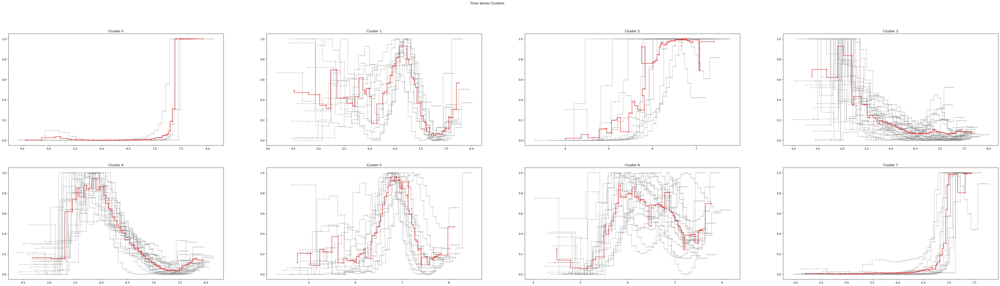

In [46]:
cluster_table = translated_ARI_cluster_tables[w2b_blc_seed_list[-1]]
plot_cluster_table(cluster_table=cluster_table,
                   Msmc_clustering_obj=Msmc_clustering_obj,
                   clusts = 8,
                   x_aspect = 64,
                   y_aspect = 8,
                   cols = 4,
                   plot_barycenters = True)

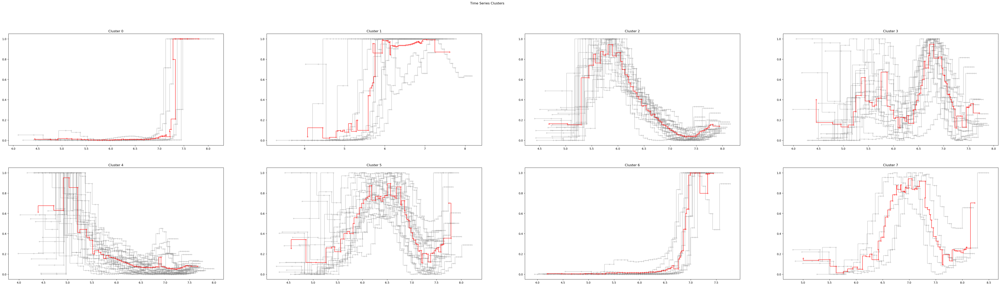

In [47]:
cluster_table = translated_ARI_cluster_tables[w2b_blc_seed_list[-2]]
plot_cluster_table(cluster_table=cluster_table,
                   Msmc_clustering_obj=Msmc_clustering_obj,
                   clusts = 8,
                   x_aspect = 64,
                   y_aspect = 8,
                   cols = 4,
                   plot_barycenters = True)

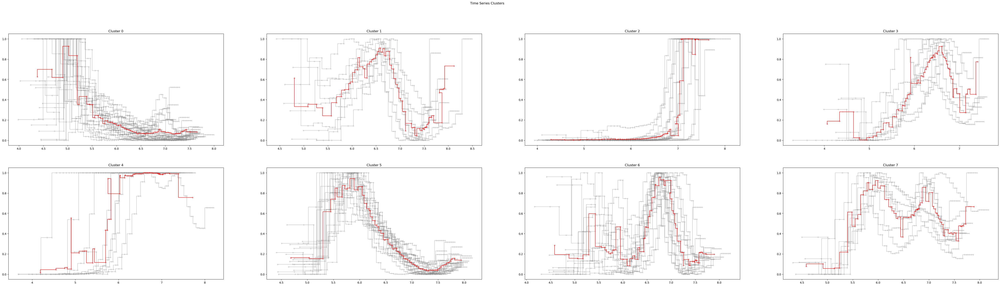

In [49]:
cluster_table = translated_ARI_cluster_tables[w2b_blc_seed_list[0]]
plot_cluster_table(cluster_table=cluster_table,
                   Msmc_clustering_obj=Msmc_clustering_obj,
                   clusts = 8,
                   x_aspect = 64,
                   y_aspect = 8,
                   cols = 4,
                   plot_barycenters = True)

In [51]:
'''
ANOVA notes (Analysis of variance)

Group/Level: Groups within the same independent variable (14 cluster labels means 14 groups/levels)
INDEPENDENT VAR:    CLUSTER LABELS
DEPENDENT VARS:     FEATURES

NULL HYP: Means are equal
ALT  HYP: Means are not equal

F-value = (btwn group variation/within group variation)
F critical value = specific value to compare F-value to

If F-statistic is statsig -> stuff didn't happen by chance
o.w. throw test data out and don't reject null hyothesis
- Need to use F-stat and P-val for deciding if overall results are significan
    -Significant F-stat just compares joint effect of all variables

Evaluate P-value, then F-value to determine significance. F-value is used only alongside P-value
Req1: Reject Null Hypothesis when P-value < alpha (small).
Req2: Do not reject Null if Critical F-value < F-value, unless P-value is small
- Large F-value means something is significant
- Small P-value means all your results are significant
- Reject Null hypothesis only if P-value < alpha


- Extension of t-test (testing 2 groups to see a sig diff in means)
- ANOVA can test more than 2 groups unlike t-test
- ANOVA looks for within and between group variation
- ANOVA Test software should return F-value (Tells you if means btwn 2 pops are sig diff like T-test)
    - F = 5.2, p-value = 0.1 means that we likely reject NULL HYP.
- F-test tells you if a group is jointly significant vs how a T-test tells you if
  a single variable is statistically significant
- 

- anova and glm are great
    - Run anova on my favorite trait (HWI or mass)
        - ANOVA will tell me if there is something going on within the trait grouping, but not what specifically (nothing like between group diffs)
    - For traits that return a nice ANOVA result, see if their within cluster groupings are sig (T-test on the means of each box -> find p-value for diff)
    - Rerun normalization with something like the median instead of the max
    - Repeat ANOVA to see if anything improved
    - Find a value like inertia or some sort of time series variance 

    - Labels: Curve Cluster Assignments
    - Features: ANOVA Traits (Continuous values)
'''
# See for one example of ANOVA: https://www.scribbr.com/statistics/one-way-anova/#:~:text=Use%20a%20one%2Dway%20ANOVA%20when%20you%20have%20collected%20data,three%20different%20groups%20or%20categories).
# See for more documentation: https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.f_oneway.html
from scipy.stats import f_oneway

def run_anova(data: "df.dataframe"):
    anova_results = dict()
    for trait in data:
        if not isinstance(data[trait].iloc[0], str) and not np.isnan(data[trait].iloc[0]):
            # Feed in list where each entry is a df or something corresponding to one label
            anova_input = []
            for i in sorted(data["Labels"].unique()):
                entry = data.loc[data["Labels"] == i][trait].tolist()
                anova_input.append(entry)
            anova_output = f_oneway(*anova_input)
            anova_results[trait] = anova_output
    return anova_results

In [52]:
anova_results = run_anova(df_joined)

/usr/local/lib/python3.8/dist-packages/scipy/stats/stats.py:3650: F_onewayConstantInputWarning: Each of the input arrays is constant;the F statistic is not defined or infinite
  warnings.warn(F_onewayConstantInputWarning())


In [53]:
a = 0.05
significant_anova_results = {key:val for key, val in anova_results.items() if val[1] < a}
non_significant_anova_results = {key:val for key, val in anova_results.items() if val[1] >=a}

In [54]:
non_significant_anova_results

{'Total.individuals': F_onewayResult(statistic=1.7005554726731626, pvalue=0.11160653434026722),
 'Female': F_onewayResult(statistic=1.5836906518091944, pvalue=0.14299681172930262),
 'Male': F_onewayResult(statistic=1.2133735257761538, pvalue=0.2977137306360818),
 'Unknown': F_onewayResult(statistic=0.6948789750402126, pvalue=0.6763272623098415),
 'Complete.measures': F_onewayResult(statistic=1.2074534111023665, pvalue=0.3009887640988429),
 'Hand-Wing.Index': F_onewayResult(statistic=1.0816688701998411, pvalue=0.3770504290412149),
 'Habitat.Density': F_onewayResult(statistic=0.6892224323302482, pvalue=0.6810902357102825)}

In [55]:
significant_anova_results

{'Beak.Length_Culmen': F_onewayResult(statistic=4.373260923875277, pvalue=0.00017057661871545867),
 'Beak.Length_Nares': F_onewayResult(statistic=4.721788128083843, pvalue=7.060694116734357e-05),
 'Beak.Width': F_onewayResult(statistic=5.152057107233672, pvalue=2.3780874756901015e-05),
 'Beak.Depth': F_onewayResult(statistic=7.996263518450514, pvalue=2.0355614920624093e-08),
 'Tarsus.Length': F_onewayResult(statistic=6.932993663705759, pvalue=2.754193998698173e-07),
 'Wing.Length': F_onewayResult(statistic=7.075428771457184, pvalue=1.9373838709358212e-07),
 'Kipps.Distance': F_onewayResult(statistic=4.167847912032832, pvalue=0.00028675440088544367),
 'Secondary1': F_onewayResult(statistic=6.726831611925874, pvalue=4.5894287320235935e-07),
 'Tail.Length': F_onewayResult(statistic=4.736022479489605, pvalue=6.810858386753965e-05),
 'Mass': F_onewayResult(statistic=4.594157204783489, pvalue=9.753051600147942e-05),
 'Migration': F_onewayResult(statistic=2.6365652501703, pvalue=0.01293633426

In [ ]:
import pandas as pd
from shapely.geometry import Point
import geopandas as gpd
from geopandas import GeoDataFrame

In [ ]:
df_joined_passeriformes['Centroid.Longitude']
df_joined_passeriformes['Centroid.Latitude']

Latin name
Mohoua_ochrocephala          -45.19
Aegithalos_caudatus           51.23
Atrichornis_clamosus         -34.31
Bombycilla_garrulus           61.26
Phainopepla_nitens            29.77
                              ...  
Mystacornis_crossleyi        -18.74
Vidua_macroura                -3.03
Vireo_altiloquus              20.76
Hypocryptadius_cinnamomeus     7.60
Zosterops_hypoxanthus         -4.25
Name: Centroid.Latitude, Length: 103, dtype: float64

In [ ]:
# geometry = [Point(xy) for xy in zip(df['Longitude'], df['Latitude'])]


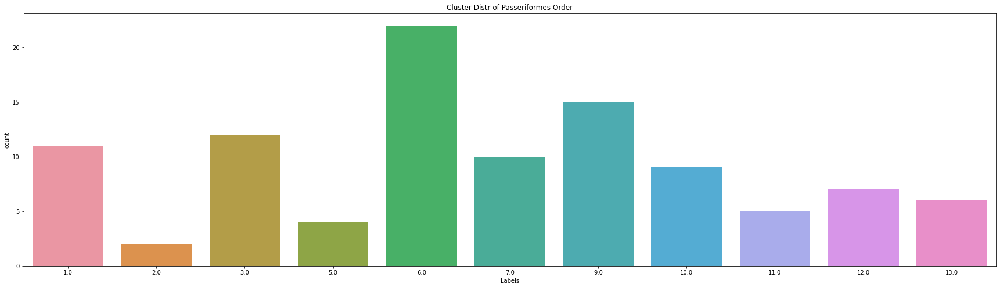

In [ ]:
plt.figure(figsize=(30,8))
plt.title("Cluster Distr of Passeriformes Order")
ac_countplot = sns.countplot(data = df_joined_passeriformes.reset_index(), x = "Labels",  hue="Labels", dodge=False)
ac_countplot.legend_.remove()

In [ ]:
'''
1.) Heatmaps with categorical vars
2.) Look at samples in interesting cluster
3.) t-test with boxplots and cluster labels
4.) Long-Lat plotting with cluster labels
'''

'\n1.) Heatmaps with categorical vars\n2.) Look at samples in interesting cluster\n3.) t-test with boxplots and cluster labels\n4.) Long-Lat plotting with cluster labels\n'